In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [16]:
import numpy as np
import pylab as plt
import glob
import os
import scipy.integrate as inte
import scipy.special as special
import scipy.interpolate as interp

In [3]:
import stephane.display.graphes as graphes
import stephane.tools.Smath as smath
#import sympy #symoblic python
import mpmath as math
import cv2
import glob

In [84]:
#savefolder = '/Users/stephane/Documents/Programming/Python/Notebooks/Drop_Turbulence/Uniform/'

osbase = '/media/turbots/DATA/thiou/'
#osbase = '/Volumes/'
base = osbase+'labshared2/Windveil/NedFacades/recaps/ImgsDewarp/'
movie = 'h1/scene4/'

datafolder = base+movie+'zone1/'
savefolder = base+movie+'results/'
if not os.path.isdir(savefolder):
    os.makedirs(savefolder)
    
title = 'h1, sc4, zo1'

In [178]:
glob.glob(base+'h*/scene*/zone*')

['/media/turbots/DATA/thiou/labshared2/Windveil/NedFacades/recaps/ImgsDewarp/h6/scene1/zone1',
 '/media/turbots/DATA/thiou/labshared2/Windveil/NedFacades/recaps/ImgsDewarp/h8/scene1/zone1',
 '/media/turbots/DATA/thiou/labshared2/Windveil/NedFacades/recaps/ImgsDewarp/h4/scene3/zone1',
 '/media/turbots/DATA/thiou/labshared2/Windveil/NedFacades/recaps/ImgsDewarp/h4/scene2/zone1',
 '/media/turbots/DATA/thiou/labshared2/Windveil/NedFacades/recaps/ImgsDewarp/h4/scene1/zone1',
 '/media/turbots/DATA/thiou/labshared2/Windveil/NedFacades/recaps/ImgsDewarp/h9/scene4/zone1',
 '/media/turbots/DATA/thiou/labshared2/Windveil/NedFacades/recaps/ImgsDewarp/h9/scene2/zone1',
 '/media/turbots/DATA/thiou/labshared2/Windveil/NedFacades/recaps/ImgsDewarp/h9/scene1/zone1',
 '/media/turbots/DATA/thiou/labshared2/Windveil/NedFacades/recaps/ImgsDewarp/h2/scene3/zone1',
 '/media/turbots/DATA/thiou/labshared2/Windveil/NedFacades/recaps/ImgsDewarp/h11/scene4/zone1',
 '/media/turbots/DATA/thiou/labshared2/Windveil/N

In [180]:
title = '/media/turbots/DATA/thiou/labshared2/Windveil/NedFacades/recaps/ImgsDewarp/h3/scene3/zone1'.split('/')[-3:]

In [181]:
str(title)

"['h3', 'scene3', 'zone1']"

In [85]:
imlist = glob.glob(datafolder+'*.tif')
print(len(imlist))

355


In [93]:
filename = imlist[0]

d={}
for i,filename in enumerate(imlist):
    j = int(os.path.basename(filename).split('.')[0])
    d[j] = cv2.imread(filename)
    #print(j)
#plt.imshow(im)

In [8]:
d[1].shape
print(d[1][10,10,:])

[66 66 66]


In [94]:
n = len(d.keys())
[nx,ny,nc] = d[1].shape
M = np.zeros((nx,ny,n))
for i in range(n):
    M[...,i] = d[i+1][...,0]

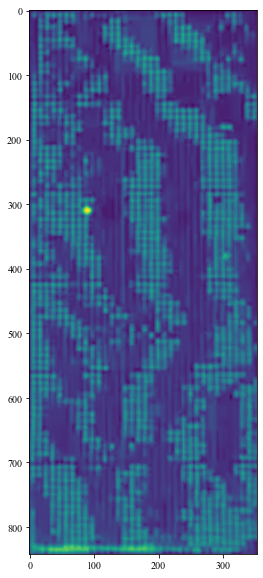

In [95]:
fig,ax = plt.subplots(nrows=1,ncols=1,figsize=(5,10))
ax.imshow(M[...,0])

In [96]:
p = 12
TF = np.fft.fft(M,axis=2,n=2**p)
TF = TF[...,:2**(p-1)]

In [56]:
print(TF.shape)

(697, 212, 2048)


In [187]:
title = '/media/turbots/DATA/thiou/labshared2/Windveil/NedFacades/recaps/ImgsDewarp/h3/scene3/zone1'.split('/')[:-1]
#print(str.join(title))

title = '/media/turbots/DATA/thiou/labshared2/Windveil/NedFacades/recaps/ImgsDewarp/h3/scene3/zone1'

print(os.path.dirname(title))

/media/turbots/DATA/thiou/labshared2/Windveil/NedFacades/recaps/ImgsDewarp/h3/scene3


2.24


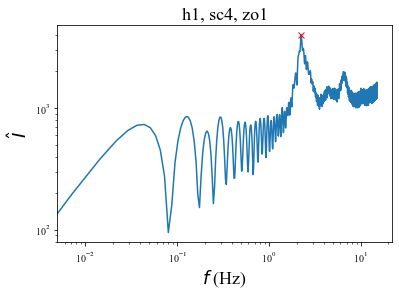

In [97]:
TF_t = np.mean(np.abs(TF),axis=(0,1))

fmax = 30/2
f = np.linspace(0,fmax,2**(p-1))
plt.plot(f,TF_t*f)
plt.xscale('log')
plt.yscale('log')

imax = np.argmax(TF_t*f)
f0  = np.round(f[imax],decimals=2)
print(f0)
Imax = TF_t[imax]*f0
plt.plot(f0,Imax,'rx')

figs = graphes.legende('$f$ (Hz)',r'$\hat I$',title)
graphes.save_figs(figs,savedir=savefolder,prefix=title)

In [131]:
def demod(t,s, fexc):
    """
    Demodulate a signal at a precise frequency, 
    for instance the frequency "fexc" of a vibrating bath

    :param: 
        * t: is a temporal vector field
        * s: is a 3D (X,Y,T) signal to be demodulated 

    :return: 
        c : (X,Y) is a 2D complex field 
    """
    c = np.mean(s*np.exp(-1j * 2 * np.pi * t[None,None,:] * fexc),axis=2)
    return c

In [60]:
d={}

TypeError: data type '' not understood

figure already exists


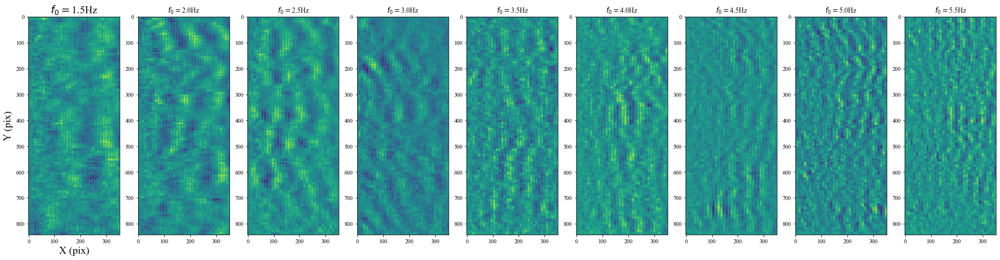

In [132]:
dt = 1/30
T = n*dt
t = np.arange(0,T,dt)
#f0 = 1.6
#d[f0] = demod(t,M,f0)

freqs = np.arange(1.5,6,0.5)
nc = len(freqs)
fig,axs = plt.subplots(nrows=1,ncols=nc,figsize=(30,20))

for i,f0 in enumerate(freqs):
    f0 = np.round(f0,decimals=2)
    d[f0] = demod(t,M,f0)
    axs[i].imshow(np.real(d[f0]))
    
    tit = '$f_0 =$'+str(f0)+'Hz'
    axs[i].set_title(tit)
    
tit = '$f_0 =$'+str(freqs[0])+'Hz'
figs = graphes.legende('X (pix)','Y (pix)',tit,ax=axs[0],cplot=True)
graphes.save_figs(figs,savedir=savefolder)

In [140]:
print(nx,ny)
print(2**10)

842 352
1024


0.5
0.79
1.08
1.37
1.66
1.95
2.24
2.53
2.82
3.11
3.39
3.68
3.97
4.26
4.55
4.84
5.13
5.42
5.71
6.0


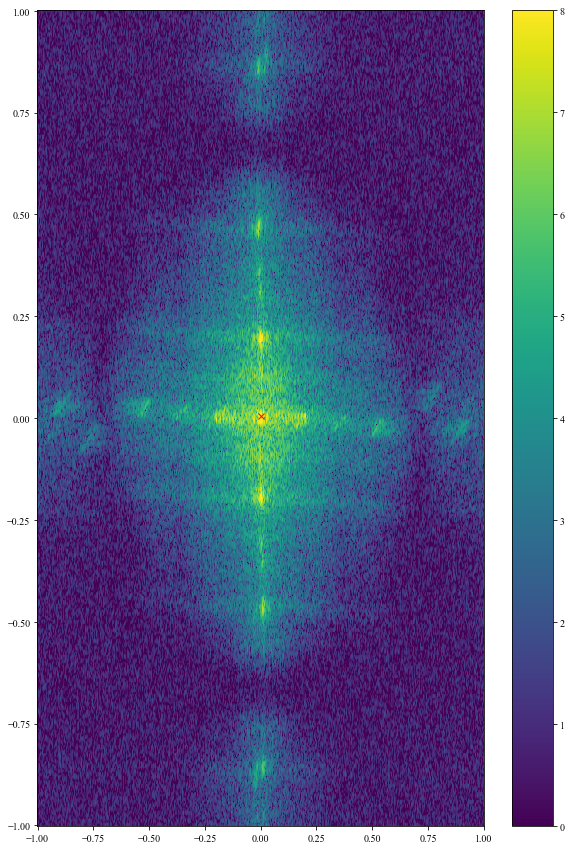

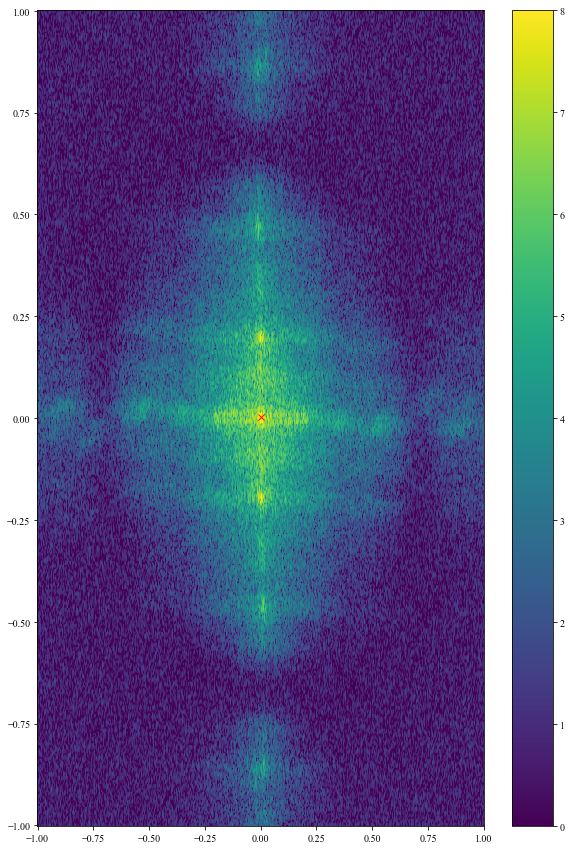

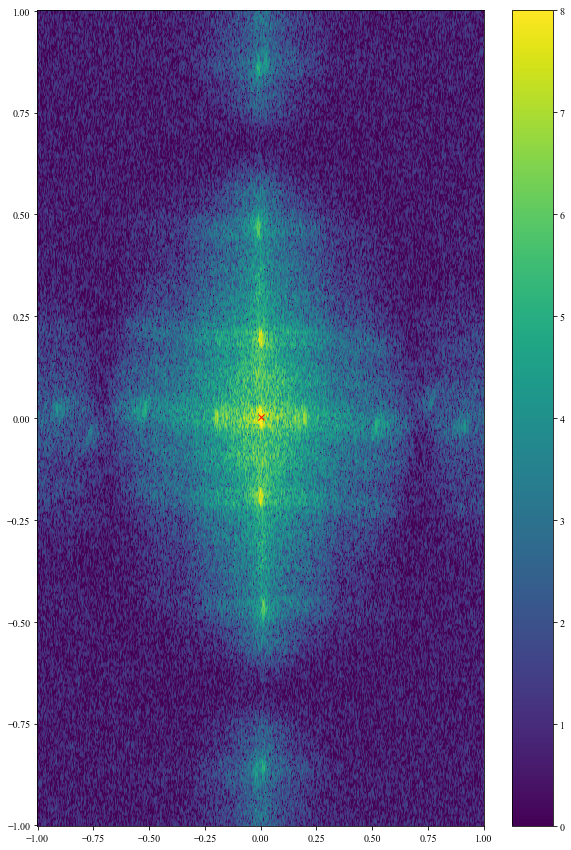

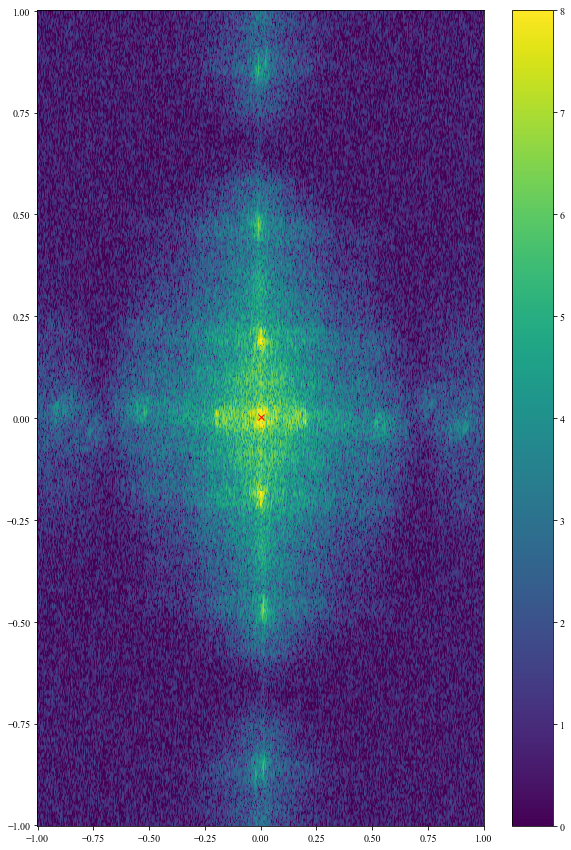

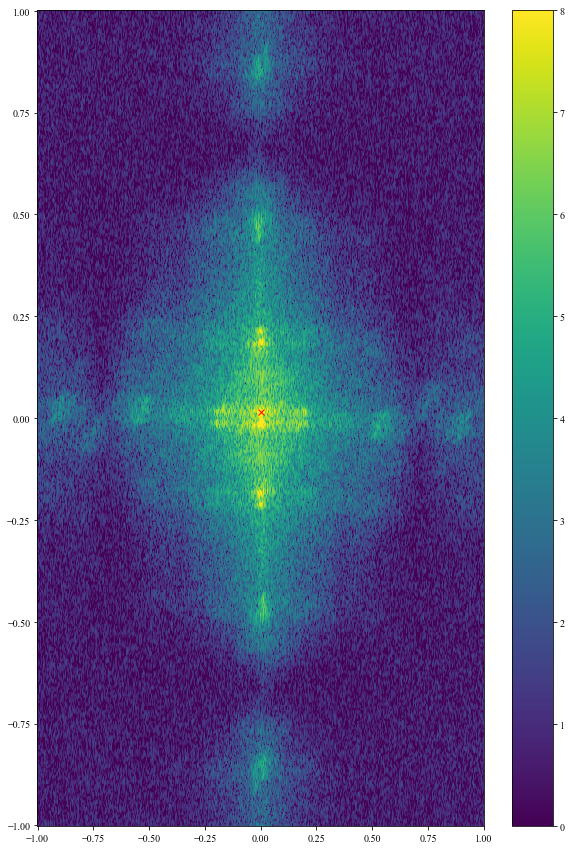

...

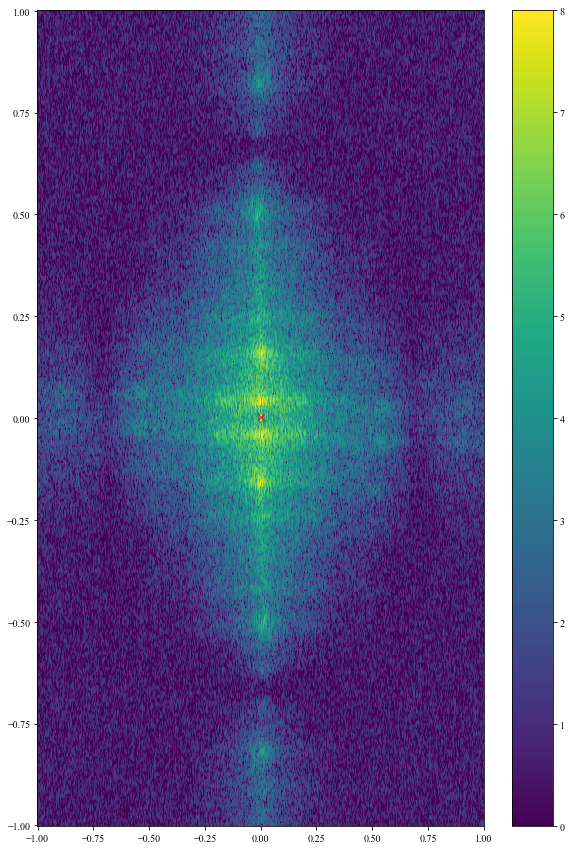

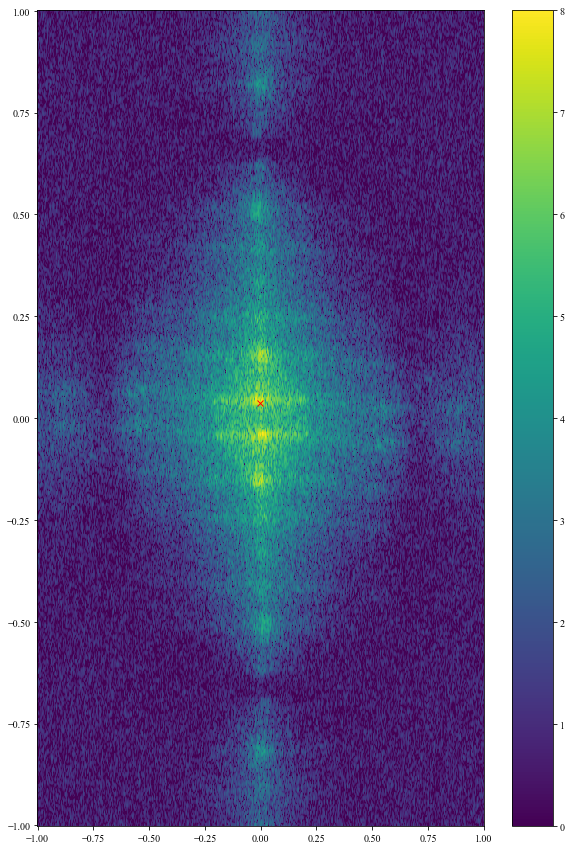

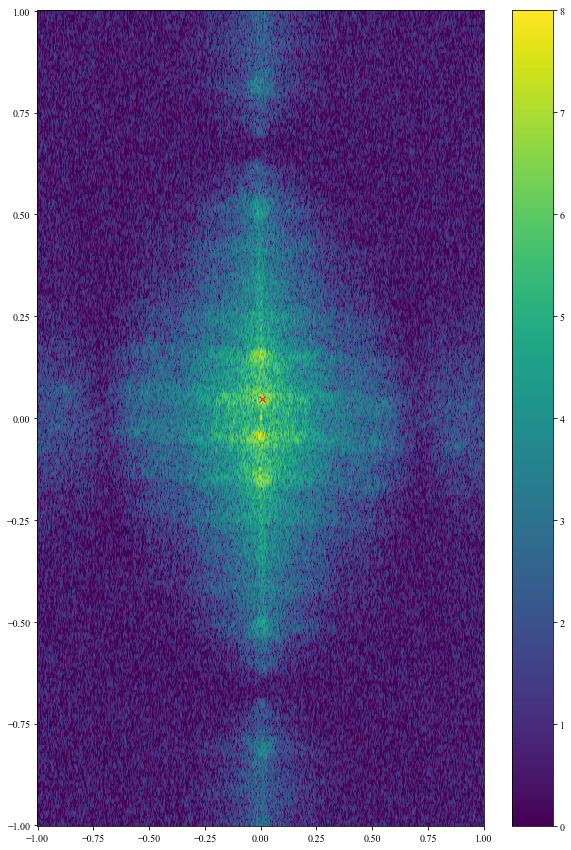

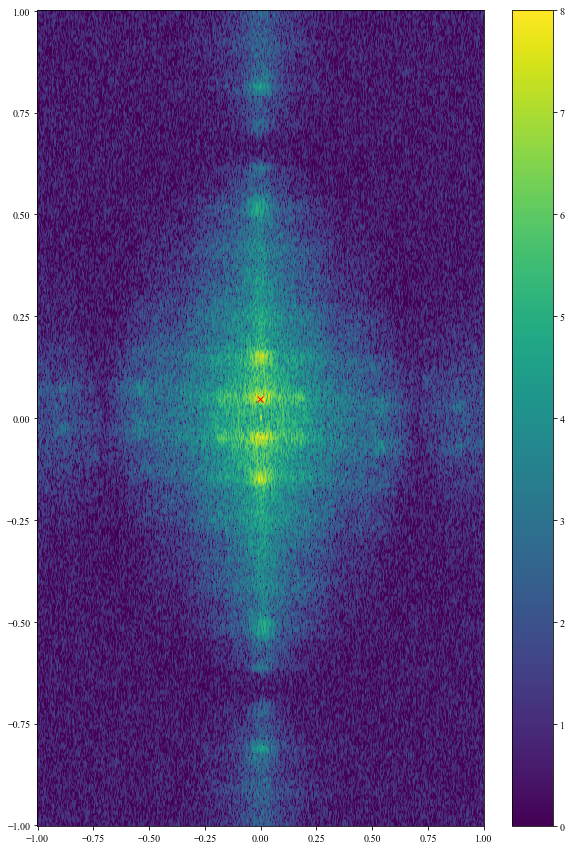

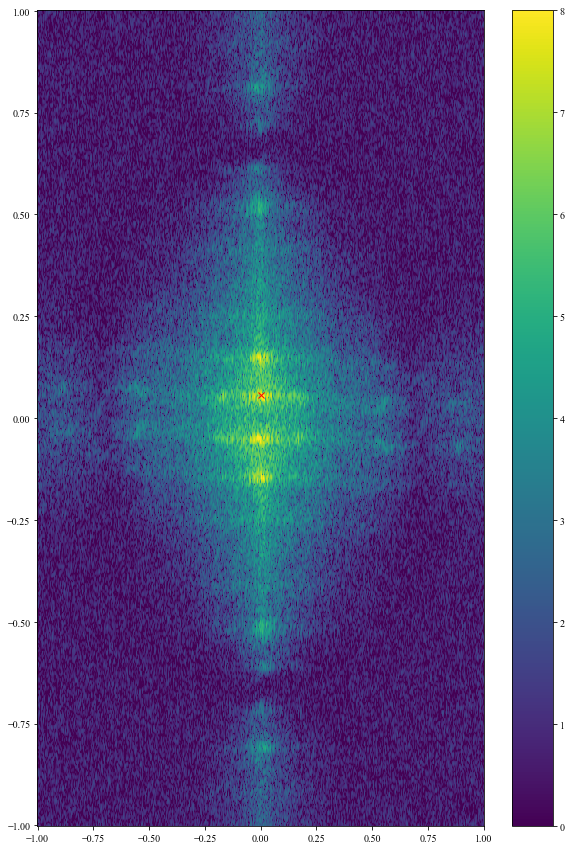

In [163]:
p=10
freqs = np.linspace(0.5,6,20)
kmax = 1
Res = {}
for i,f0 in enumerate(freqs):
    f0 = np.round(f0,decimals=2)
    print(f0)

    Y = np.real(demod(t,M,f0))

    nx,ny = Y.shape
    bx = int((2**p-nx)/2)
    by = int((2**p-ny)/2)

    wx = np.hanning(nx)
    wy = np.hanning(ny)
    W = wy[None,:]*wx[:,None]

    Y = Y*W
    
    Ypad = np.pad(Y, [(bx,bx),(by,by)], mode='constant')
    nx,ny = Ypad.shape


    #Wy,Wx = np.meshgrid(wy,wx)
    #W = np.sqrt(Wx**2+Wy**2)
    kx = np.linspace(-kmax,kmax,nx)
    ky = np.linspace(-kmax,kmax,ny)
    [Ky,Kx] = np.meshgrid(ky,kx)
    K = np.sqrt(Kx**2+Ky**2)
    
    TF_xy = np.fft.fftshift(np.fft.fft2(Ypad,s=None,norm=None))

    fig,ax = plt.subplots(nrows=1,ncols=1,figsize=(10,15))

    Z = np.abs(TF_xy)*K**(1/4)
    v = np.max(Z, axis=(0,1))
    ind = np.where(Z==v)
    i = ind[0][0]
    j = ind[1][0]
    Res[f0]={}
    
    Res[f0]['K']=K[i,j]
    Res[f0]['f']=f0
    
    
#    print(Kx[i,j],Ky[i,j])
    #sc = ax.imshow(W)
    sc = ax.pcolormesh(Kx,Ky,np.log(Z),vmin=0,vmax=8)
    plt.plot(Kx[i,j],Ky[i,j],'rx')
    plt.colorbar(sc)

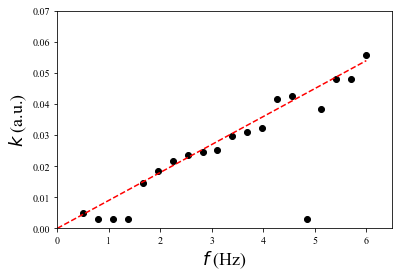

In [172]:
for f0 in Res.keys():
    plt.plot(f0,Res[f0]['K'],'ko')
    plt.axis([0,6.5,0,0.07])

a = 0.009    
fs = np.linspace(0,6,100)
plt.plot(fs,fs*a,'r--')
figs = graphes.legende('$f$ (Hz)','$k$ (a.u.)','')


In [ ]:
p=10
freqs = np.linspace(1,5,5)
kmax = 1
for i,f0 in enumerate(freqs):
    f0 = np.round(f0,decimals=2)
    print(f0)

    Y = np.real(demod(t,M,f0))

    nx,ny = Y.shape
    bx = int((2**p-nx)/2)
    by = int((2**p-ny)/2)

    wx = np.hanning(nx)
    wy = np.hanning(ny)
    W = wy[None,:]*wx[:,None]

    Y = Y*W
    
    Ypad = np.pad(Y, [(bx,bx),(by,by)], mode='constant')
    nx,ny = Ypad.shape


    #Wy,Wx = np.meshgrid(wy,wx)
    #W = np.sqrt(Wx**2+Wy**2)
    kx = np.linspace(-kmax,kmax,nx)
    ky = np.linspace(-kmax,kmax,ny)
    [Ky,Kx] = np.meshgrid(ky,kx)

    TF_xy = np.fft.fftshift(np.fft.fft2(Ypad,s=None,norm=None))

    fig,ax = plt.subplots(nrows=1,ncols=1,figsize=(10,15))

    #sc = ax.imshow(W)
    sc = ax.pcolormesh(Kx,Ky,np.log(np.abs(TF_xy)),vmin=0,vmax=8)
    plt.colorbar(sc)

In [ ]:
dt = 1/30
T = n*dt
t = np.arange(0,T,dt)
#f0 = 1.6
#d[f0] = demod(t,M,f0)

freqs = np.arange(1.4,3,0.2)
nc = len(freqs)
fig,axs = plt.subplots(nrows=1,ncols=nc,figsize=(30,20))

for i,f0 in enumerate(freqs):
    f0 = np.round(f0,decimals=2)
    d[f0] = demod(t,M,f0)
    axs[i].imshow(np.real(d[f0]))
    
    tit = '$f_0 =$'+str(f0)+'Hz'
    axs[i].set_title(tit)
    
tit = '$f_0 =$'+str(freqs[0])+'Hz'
figs = graphes.legende('X (pix)','Y (pix)',tit,ax=axs[0],cplot=True)
graphes.save_figs(figs,savedir=savefolder)

In [6]:
I={}
for filename in filelist[:3]:
    I={}
    I['fx'] = fx
    if U0==0:
        x,y = [32,383]
    else:
        x,y = [32,380]
    I[U0]['x0'] = x
    I[U0]['y0'] = y
    
# Output img with window name as 'image'
    plt.figure(figsize=(15,15))
    plt.imshow(I[U0]['im'])

In [8]:
keylist = [0,20,40,60]
for key in keylist:#key = 20
    if key ==0:
        filelist = glob.glob(datafolder+'00Hz*min.txt')
    else:
        filelist = glob.glob(datafolder+str(key)+'Hz*min.txt')
    data[key]={}
    for f in filelist:
        d = np.loadtxt(f,delimiter=',')
        if '_near_' in f:
            data[key]['near']=d
        if '_far_' in f:
            data[key]['far']=d
            

#print(filelist[1])
#print(data.shape)

In [40]:
for key in data.keys():
    xc,yc = 639,1750
    data[key]['x0']=xc
    data[key]['y0']=yc

In [21]:
fu = 1/9

In [76]:
def transport(y,t,Fr,up):
    vx,vz = y
    a = np.sqrt(((vx-1)**2+vz**2+up**2))
    dydt = [-Fr**2*a*(vx-1),-Fr**2*a*vz-1]
    return dydt

def find_zero(x,z):
    i = np.argmin(np.abs(z))
    return x[i],i

def traj(y,r0,dt):
    X = np.cumsum(y,axis=0)*dt
    x = X[:,0]+r0[0]
    z = X[:,1]+r0[1]
    return x,z

def traj_beam(thetalist,vlist,Fr,Fr0,up,display=False,N=10**5,H=0.05):
    Xlist = []
    X = []
    Z = []
    for j,(theta,v0) in enumerate(zip(thetalist,vlist)):
        y0 = [v0*np.cos(theta),v0*np.sin(theta)]#initial velocity
        t = np.linspace(0,100,N+1)
        dt = t[1]-t[0]
        sol = inte.odeint(transport, y0, t, args=(Fr,up))#c0 replaced by 0
        
        z0 = 1/Fr0**2
        x,z = traj(sol,[0,z0],dt)#get the trajectory from the velocity 
        xm,i = find_zero(x,z)
        
        if j==0:
            print(theta,t[i])

        X.append(x[:i])
        Z.append(z[:i])
        
        if display:
            plt.plot(x[:i]*Fr0**2*H,z[:i]*Fr0**2*H)
            graphes.legende('$x$ (m)','$z$ (m)','')
        Xlist.append(xm)
    return np.asarray(Xlist),X,Z

def distribution(thetalist,Xlist,sigma,display=False):#starting from a distribution of angle, what is the distribution of time of flight ?
    rho = 1/np.sqrt((2*np.pi*sigma**2))*np.exp(-thetalist**2/(2*sigma**2))
    dtheta = thetalist[1]-thetalist[0]
    if display:
        plt.semilogy(thetalist,rho,'ko')

    dTh = dtheta/np.diff(Xlist)
    rhom = (rho[1:]+rho[:-1])/2
    rho_x = rhom*dTh
    xm = (Xlist[1:]+Xlist[:-1])/2
    thetam = (thetalist[1:]+thetalist[:-1])/2
    if display:
        plt.figure()
        plt.semilogy(xm,rho_x,'ro')
    return xm,rho_x

def transport_noise(y,t,fun,Fr,alpha):#alpha = H/l, where l is the friction length
    vx,vz = y
    a = np.sqrt(((vx-Fr)**2+vz**2))
    dydt = [-alpha*a*(vx-Fr)+fun(t)[0],-alpha*a*vz-1+fun(t)[1]]
    return dydt

def transport_noise_real(y,t,fun,Fr,alpha):#alpha = H/l, where l is the friction length
    vx,vz = y
    a = np.sqrt(((vx-Fr*(1+fun(t)[0]))**2+(vz-Fr*fun(t)[1])**2))
    dydt = [-alpha*a*(vx-Fr*(1+fun(t)[0])),-alpha*a*(vz-Fr*fun(t)[1])-1]
    return dydt

#create the noise
def make_noise_2d(t,sigma,nc):
    n = len(t)
    a = np.random.multivariate_normal([0.,0.],[[sigma**2,0],[0,sigma**2]], size=n+nc,)
    b = np.cumsum(a,axis=0)
    c = b[nc:,:]-b[:-nc,:]
    c = c/np.sqrt(nc)
    
    cf1 = interp.interp1d(t, c[:,0], kind='cubic')
    cf2 = interp.interp1d(t, c[:,1], kind='cubic')
    cfun = lambda x:(cf1(x),cf2(x))
    return c,cfun

def traj_noise(theta,Fr,Fr0,sigma,nc,display=False,N=10**5):
    y0 = [v0*np.cos(theta),v0*np.sin(theta)]#initial velocity
    t = np.linspace(0,10,N+1)
    dt = t[1]-t[0]
    tnoise = np.linspace(0,11,int(N*1.1+1))
    
    c,cfun = make_noise_2d(tnoise,sigma,nc)

    dt = t[1]-t[0]
    sol = inte.odeint(transport_noise_real, y0, t,args=(cfun,Fr),hmin=dt)#c0 replaced by 0
    x,z = traj(sol,[0,1],dt)#get the trajectory from the velocity 
    xm,i = find_zero(x,z)
        
    print(theta,t[i])

    if display:
        plt.plot(x[:i],z[:i])
    return x[:i],z[:i],xm

def traj_beam_noise(thetalist,*args,**kwargs):
    Xlist = []
    for j,theta in enumerate(thetalist):
        x,z,xm = traj_noise(theta,args,kwargs)
        Xlist.append(xm)
    return np.asarray(Xlist)

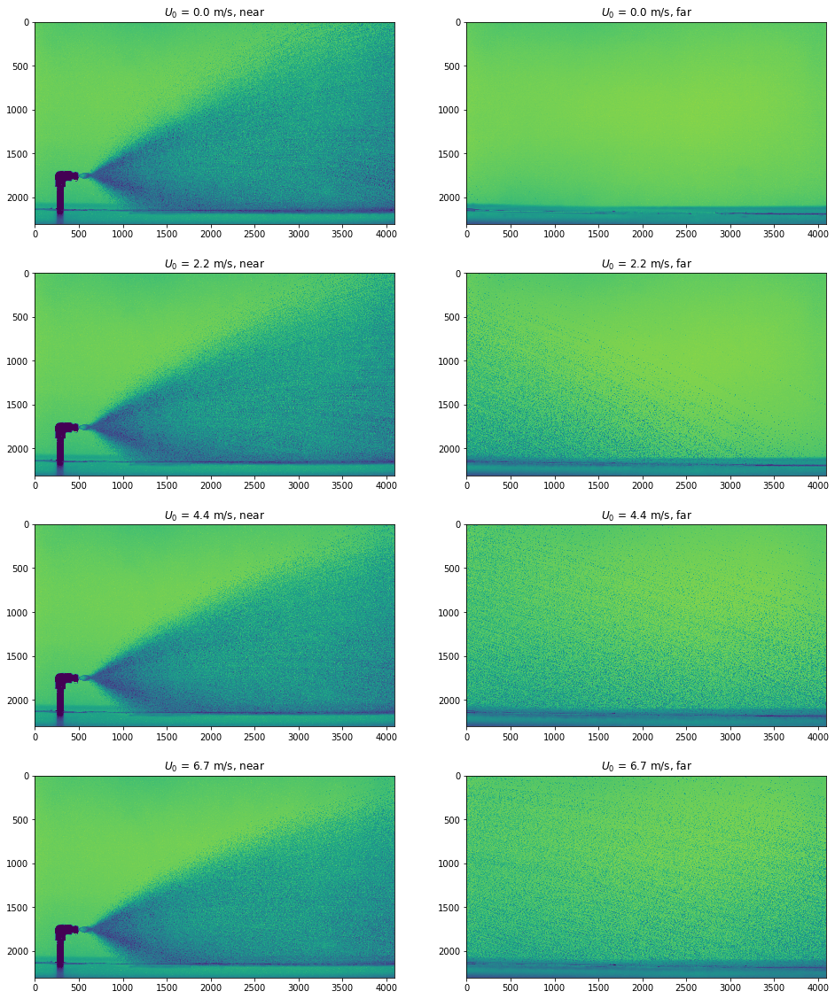

In [30]:
key = 20
keylist = [0,20,40,60]
fig = plt.figure(figsize=(16,20))
ax = fig.subplots(ncols=2,nrows=4)
for i,key in enumerate(keylist):
    axes = {'near':ax[i,0],'far':ax[i,1]}
    for k in data[key].keys():
        axes[k].imshow(data[key][k])        
#        fig.gca()
        U0 = np.round(key*fu,decimals=1)
        axes[k].set_title('$U_0$ = '+str(U0)+' m/s, '+k)
#        plt.title(k)

graphes.save_fig(0,savefolder+'all_images',frmt='png',dpi=100,overwrite=False)
#graphes.legende(None,None,None,cplot=True)

In [80]:
def plot_trajectories(data,axs,Fr,Fr0,up,vlist,thetalist,color='w--'):
    fx = 0.132 
    H = 0.05
    Hmm = H*1000

    xc = data['x0']
    yc = data['y0']

    Xlist,X,Z = traj_beam(thetalist,vlist,Fr,Fr0,up,display=False,N=10**5,H=H)

    for i,k in enumerate(['near','far']):
        if k=='near':
            xf = 0
        else:
            xf = -1491/fx#distance in pix

        for x,z in zip(X,Z):
            axs[i].plot(x*Fr0**2*Hmm/fx+xc+xf,-z*Fr0**2*Hmm/fx+yc+Hmm/fx,color)
    #plt.axis([0,4000,2500,0])

    #figs = {}
    #figs.update(graphes.legende('$X$ (pixel)','$Z$ (pixel)','$U_0$ = '+str(U0)+' m/s'))
    
#graphes.save_figs(figs,savedir=savefolder,frmt='png',prefix = 'fit_U0'+str(int(key*100)))

In [42]:
data[40].keys()

dict_keys(['far', 'near', 'x0', 'y0'])

1.1664
0.6283185307179586 47.799
0.6283185307179586 2.08
0.6283185307179586 1.117
0.6283185307179586 0.73


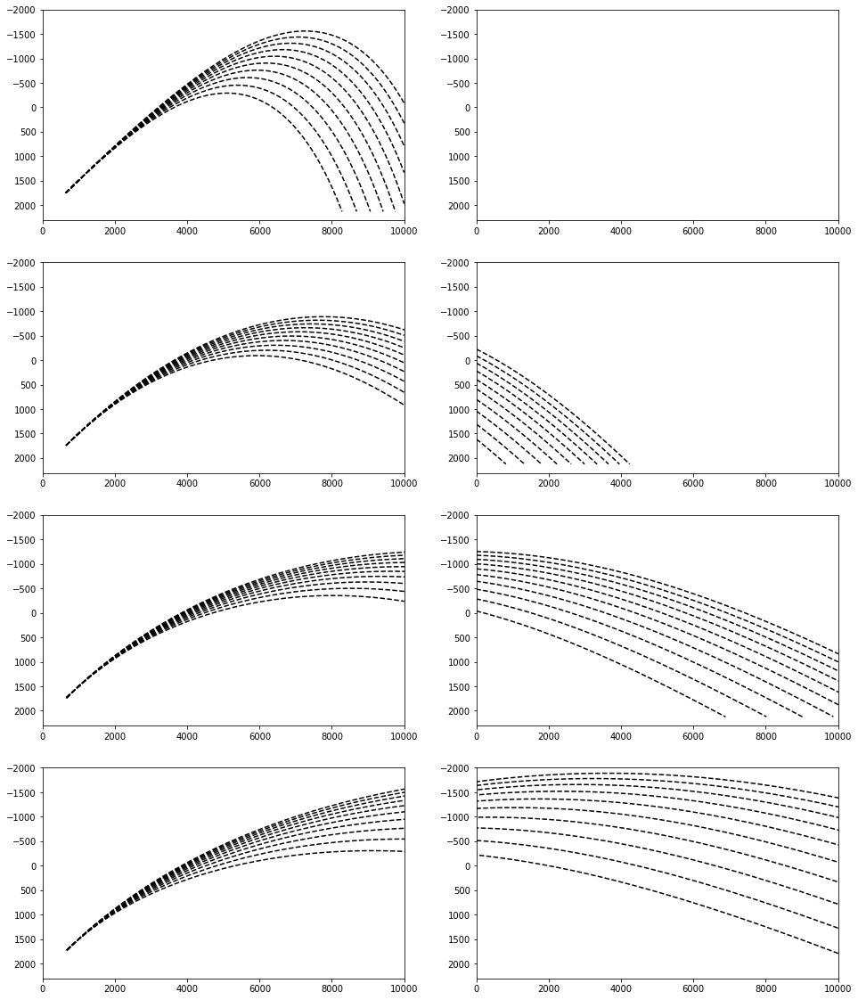

In [94]:
eps = 0
U0 = key*fu#fit[key]['U0']
print(v1)
eps = 0.25
g = 9.81
H = 0.05


#thetalist = np.linspace(-np.pi/4,3*np.pi/8,15)
#vlist = v1*np.ones(len(thetalist))

fig = plt.figure(figsize=(16,20))
ax = fig.subplots(ncols=2,nrows=4)
key = 60

for i,key in enumerate(keylist):
    U0 = key*fu#fit[key]['U0']
    if U0==0:
        U0=0.1
    Fr = fit[key]['Fr']*1.25#0.71/2.38/10#2*2.38/6.67
    vreal = fit[key]['vr']*1.2 #initial velocity, in unit of U0
    v1 = vreal/U0*1.2
    Fr0 = U0/np.sqrt(g*H)

    vlist = np.linspace(v1*(1-eps),v1*(1+eps),10)
    thetalist = np.pi/5*np.ones(len(vlist))#np.linspace(-np.pi/4,3*np.pi/8,15)
    plot_trajectories(data[key],ax[i,:],Fr,Fr0,0,vlist,thetalist,color='k--')
    ax[i,0].axis([0,10000,ny,-2000])
    ax[i,1].axis([0,10000,ny,-2000])


In [62]:
ny,nx = data[60]['far'].shape
print(nx,ny)

4096 2304


In [66]:
0.714*1.25

0.8925

In [137]:
2.5/6.67

0.37481259370314846

In [1]:
keys = ['U0','Fr','vr']
fit = {}
v0 = 5.4
fit[60] = {'U0':6.67,'Fr':2.5,'vr':v0}
fit[40] = {'U0':4.76,'Fr':1.79,'vr':v0}
fit[20] = {'U0':2.38,'Fr':0.89,'vr':v0}
fit[0] = {'U0':0.1,'Fr':0.0375,'vr':v0} 
# Froude has to be small, but the value does not matter (singular limit)

In [2]:
key = 60
g=9.81
fit[key]['U0']**2/fit[key]['Fr']**2/g

0.7256089704383283

In [145]:
v0*(1-eps)

4.050000000000001

In [136]:
rho = 1000
rho_a = 1.5
Cx = 2
d = lambda x:Cx*3*rho_a/rho/4*x

key = 0

d(fit[key]['U0']**2/fit[key]['Fr']**2/g)

0.0025484199796126407

0.6283185307179586 39.587
0.0 13.316
0.6283185307179586 39.587
0.0 13.316
0.6283185307179586 1.8960000000000001
0.0 0.589
0.6283185307179586 1.8960000000000001
0.0 0.589
0.6283185307179586 0.9430000000000001
0.0 0.271
0.6283185307179586 0.9430000000000001
0.0 0.271
0.6283185307179586 0.589
0.0 0.181
0.6283185307179586 0.589
0.0 0.181


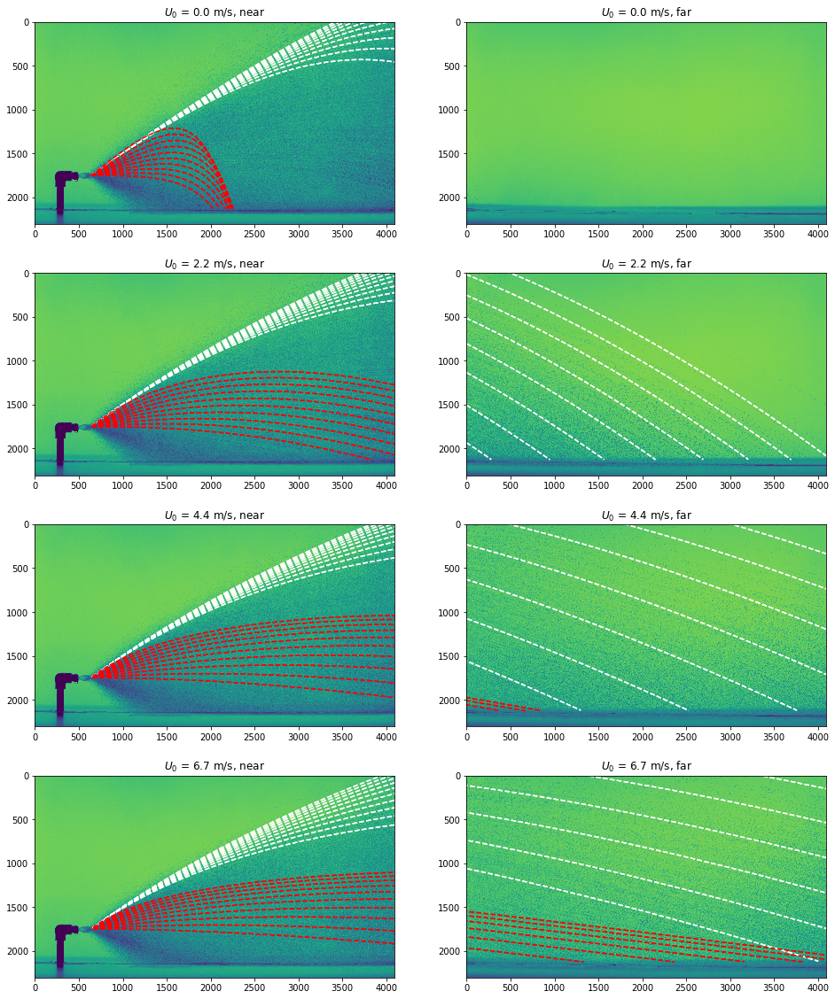

In [139]:
key = 20
keylist = [0,20,40,60]

# smaller particles : we don't change IC, but we change
# Froude number is increased by sqrt(d0/dp)
d0 = 1000
dp = 100


fig = plt.figure(figsize=(16,20))
ax = fig.subplots(ncols=2,nrows=4)
for i,key in enumerate(keylist):
    axes = {'near':ax[i,0],'far':ax[i,1]}
    for k in ['near','far']:
        axes[k].imshow(data[key][k])        
#        fig.gca()
        Utitle = np.round(key*fu,decimals=1)
        
        U0 = key*fu#fit[key]['U0']
        if U0==0:
            U0=0.1
        Fr = fit[key]['Fr']#0.71/2.38/10#2*2.38/6.67
        vreal = fit[key]['vr'] #initial velocity, in m/s
        v1 = vreal/U0
        Fr0 = U0/np.sqrt(g*H)

        vlist = np.linspace(v1*(1-eps),v1*(1+eps),10)
        thetalist = np.pi/5*np.ones(len(vlist))#np.linspace(-np.pi/4,3*np.pi/8,15)
        plot_trajectories(data[key],ax[i,:],Fr,Fr0,0,vlist,thetalist,color='w--')
        
        Fr_s = fit[key]['Fr']*np.sqrt(d0/dp)#0.71/2.38/10#2*2.38/6.67
        thetalist_s = np.linspace(0,np.pi/3,15)
        vlist_s = v1*np.ones(len(thetalist))#np.linspace(v1*(1-eps),v1*(1+eps),10)
        
        plot_trajectories(data[key],ax[i,:],Fr_s,Fr0,0,vlist_s,thetalist_s,color='r--')
#        plt.title(k)
        axes[k].set_title('$U_0$ = '+str(Utitle)+' m/s, '+k)
        axes[k].axis([0,nx,ny,0])
            

graphes.save_fig(0,savefolder+'all_images_fit_double_size_sansfluct',frmt='png',dpi=100,overwrite=True)
#graphes.legende(None,None,None,cplot=True)

In [111]:
for i,key in enumerate([20,40,60]):    
    U0 = key*fu#fit[key]['U0']
    Fr = fit[key]['Fr']#0.71/2.38/10#2*2.38/6.67
    
    l = U0**2/Fr**2/g
    print(l)
    print(l*dp/d0)

0.6355152138759484
0.06355152138759484
0.6284343196668504
0.06284343196668504
0.7865493764236542
0.07865493764236542


0.0 12.794
0.0 12.794
0.0 0.602
0.0 0.602
0.0 0.306
0.0 0.306
0.0 0.219
0.0 0.219


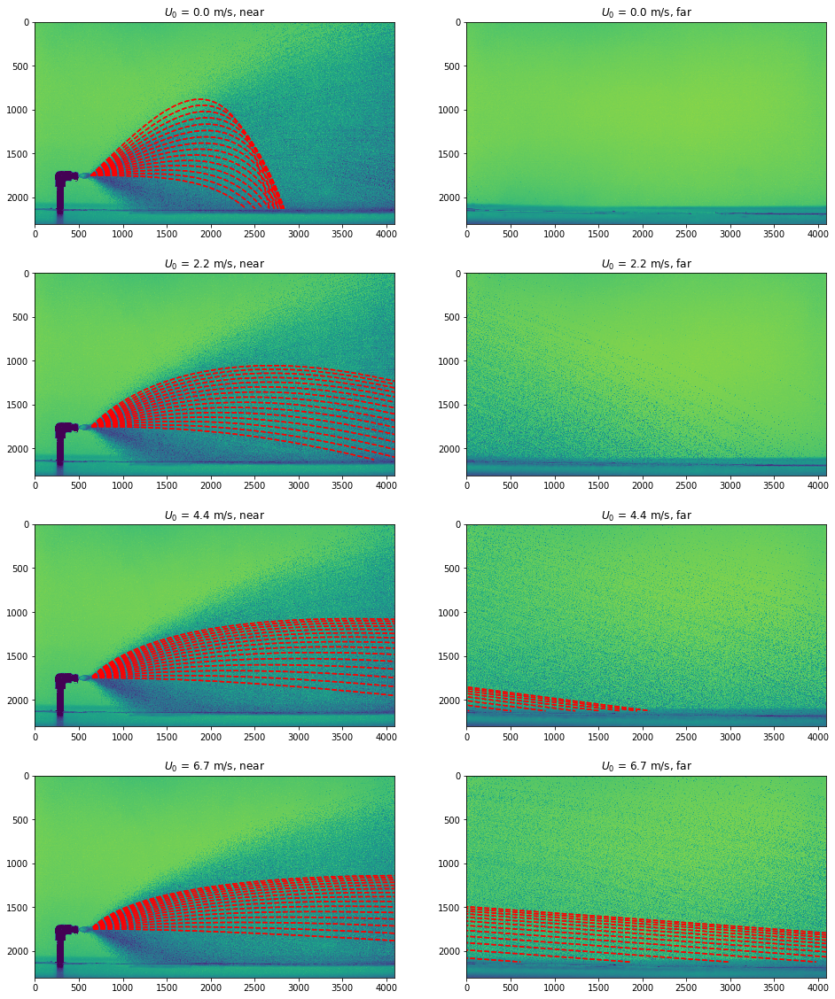

In [98]:


key = 20
keylist = [0,20,40,60]
fig = plt.figure(figsize=(16,20))
ax = fig.subplots(ncols=2,nrows=4)
for i,key in enumerate(keylist):
    axes = {'near':ax[i,0],'far':ax[i,1]}
    for k in ['near','far']:
        axes[k].imshow(data[key][k])        
#        fig.gca()
        Utitle = np.round(key*fu,decimals=1)
        
        U0 = key*fu#fit[key]['U0']
        if U0==0:
            U0=0.1
        vreal = fit[key]['vr'] #initial velocity, in m/s
        v1 = vreal/U0
        Fr0 = U0/np.sqrt(g*H)

        #vlist = np.linspace(v1*(1-eps),v1*(1+eps),10)
        Fr_s = fit[key]['Fr']*np.sqrt(d0/dp)#0.71/2.38/10#2*2.38/6.67
        thetalist_s = np.linspace(0,np.pi/4,15)
        vlist_s = v1*np.ones(len(thetalist))#np.linspace(v1*(1-eps),v1*(1+eps),10)
        
        plot_trajectories(data[key],ax[i,:],Fr_s,Fr0,0.2,vlist_s,thetalist_s,color='r--')
#        plt.title(k)
        axes[k].set_title('$U_0$ = '+str(Utitle)+' m/s, '+k)
        axes[k].axis([0,nx,ny,0])
            

#graphes.save_fig(0,savefolder+'all_images_fit',frmt='png',dpi=100,overwrite=True)
#graphes.legende(None,None,None,cplot=True)

395
0.12658227848101267


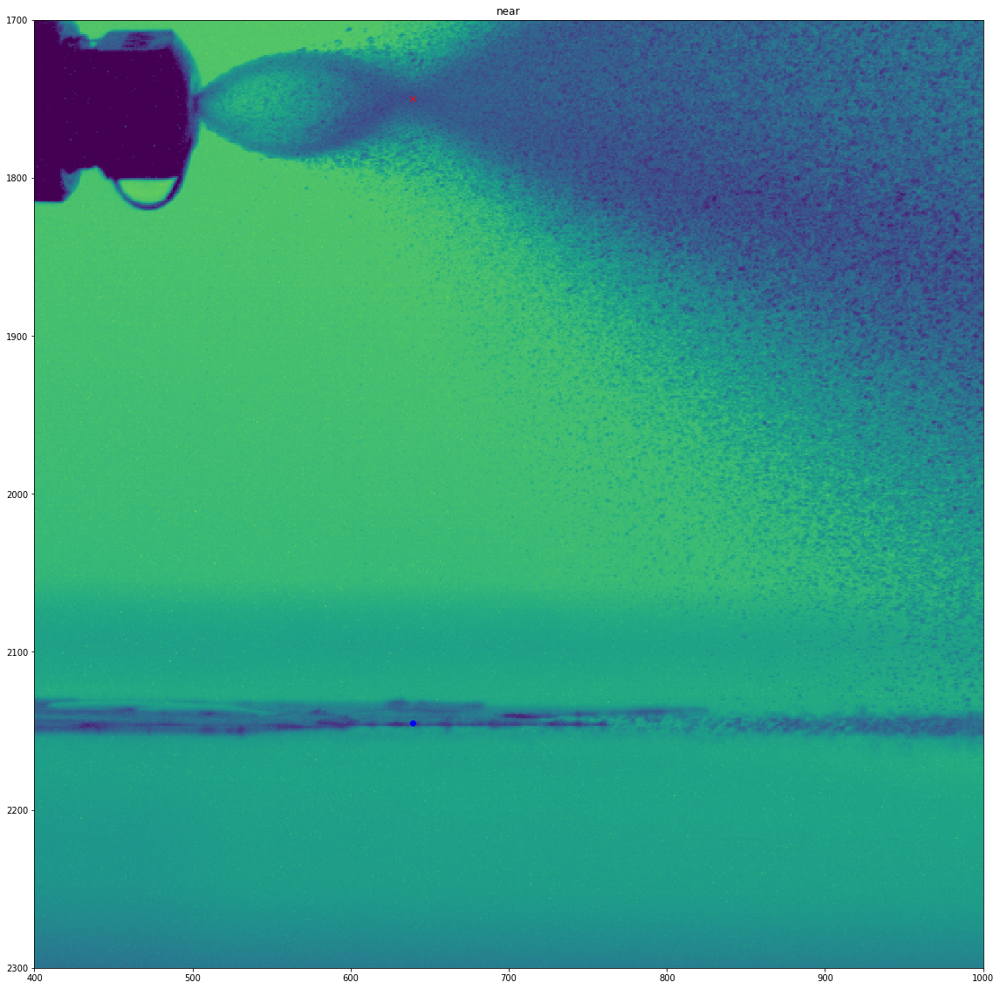

In [67]:
key = 20
plt.figure(figsize=(20,20))
plt.imshow(data[key]['near'])
plt.title(k)
plt.axis([400,1000,2300,1700])
#plt.axis([600,700,1800,1700])
xc,yc = 639,1750
data[key]['x0']=xc
data[key]['y0']=yc
plt.plot(xc,yc,'rx')
yb = 2145
plt.plot(xc,yb,'bo')
print(2145-1750)
fx = 50/395
print(fx)

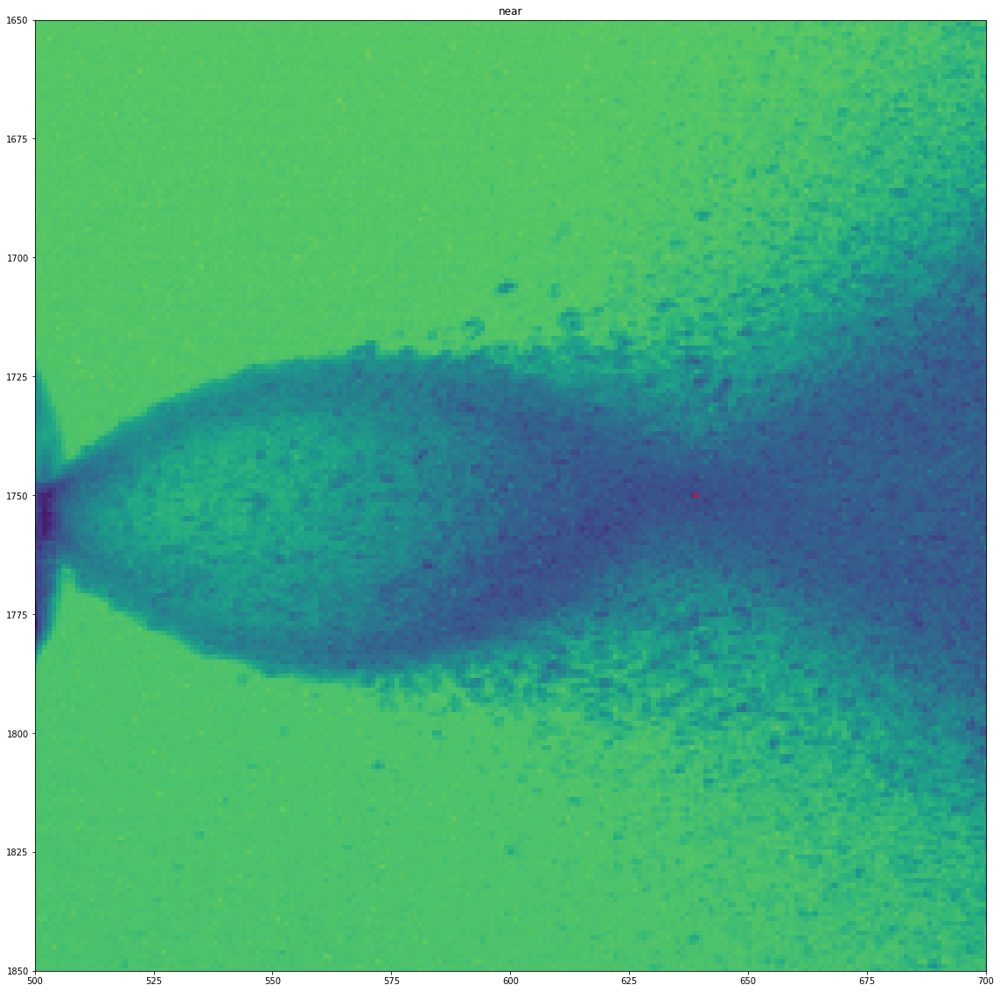

In [48]:
key = 20
plt.figure(figsize=(20,20))
plt.imshow(data[key]['near'])
plt.title(k)
plt.axis([500,700,1850,1650])
#plt.axis([600,700,1800,1700])
xc,yc = 639,1750
data[key]['x0']=xc
data[key]['y0']=yc
plt.plot(xc,yc,'rx')

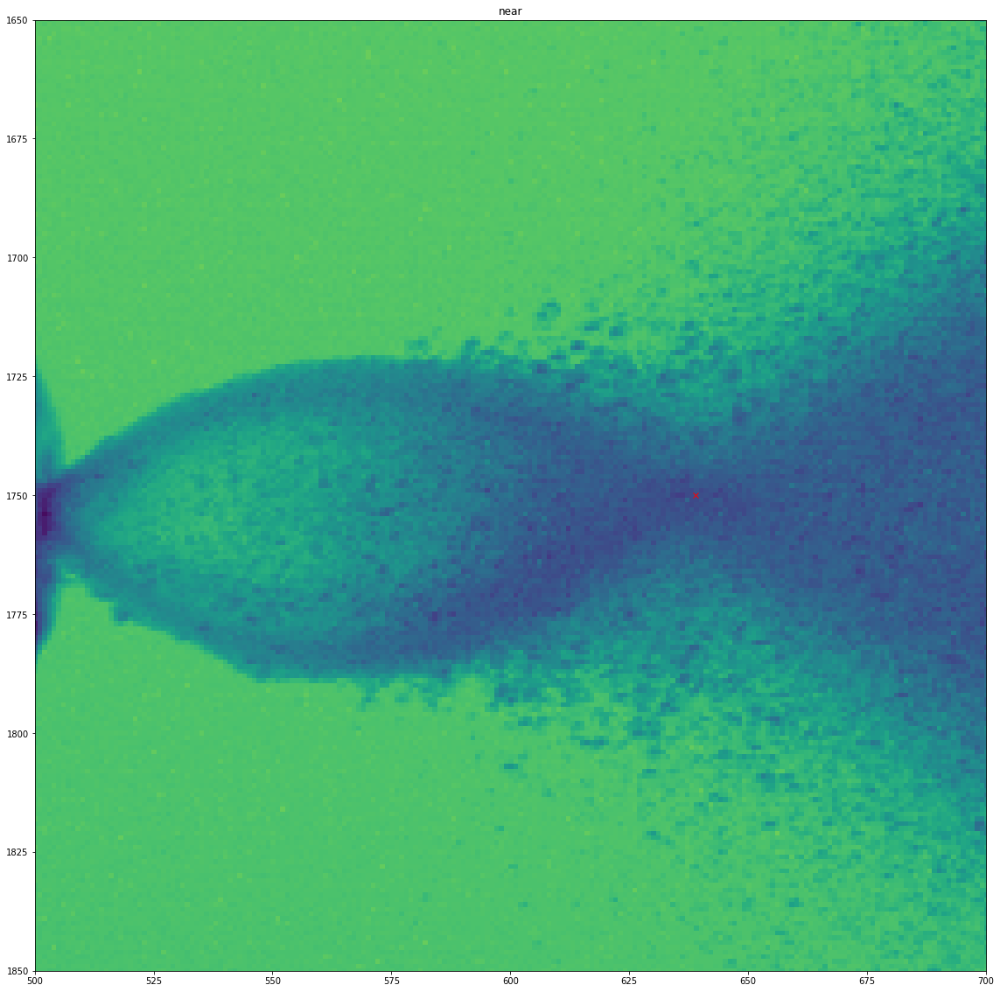

In [51]:
key = 40
plt.figure(figsize=(20,20))
plt.imshow(data[key]['near'])
plt.title(k)
plt.axis([500,700,1850,1650])
#plt.axis([600,700,1800,1700])
xc,yc = 639,1750
data[key]['x0']=xc
data[key]['y0']=yc
plt.plot(xc,yc,'rx')

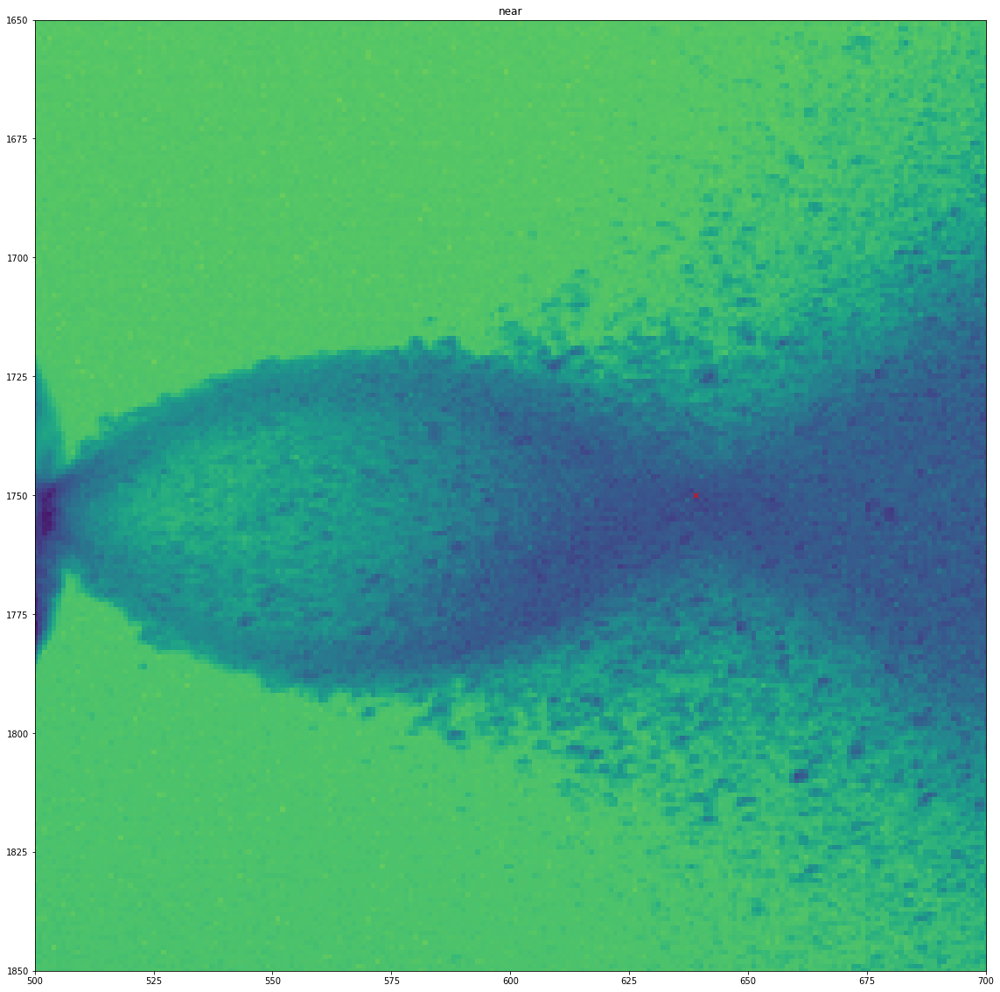

In [52]:
key = 60
plt.figure(figsize=(20,20))
plt.imshow(data[key]['near'])
plt.title(k)
plt.axis([500,700,1850,1650])
#plt.axis([600,700,1800,1700])
xc,yc = 639,1750
data[key]['x0']=xc
data[key]['y0']=yc
plt.plot(xc,yc,'rx')

In [55]:
0.714*2

1.428

In [147]:
fx = 0.132

1.2959999999999998
0.6283185307179586 0.992


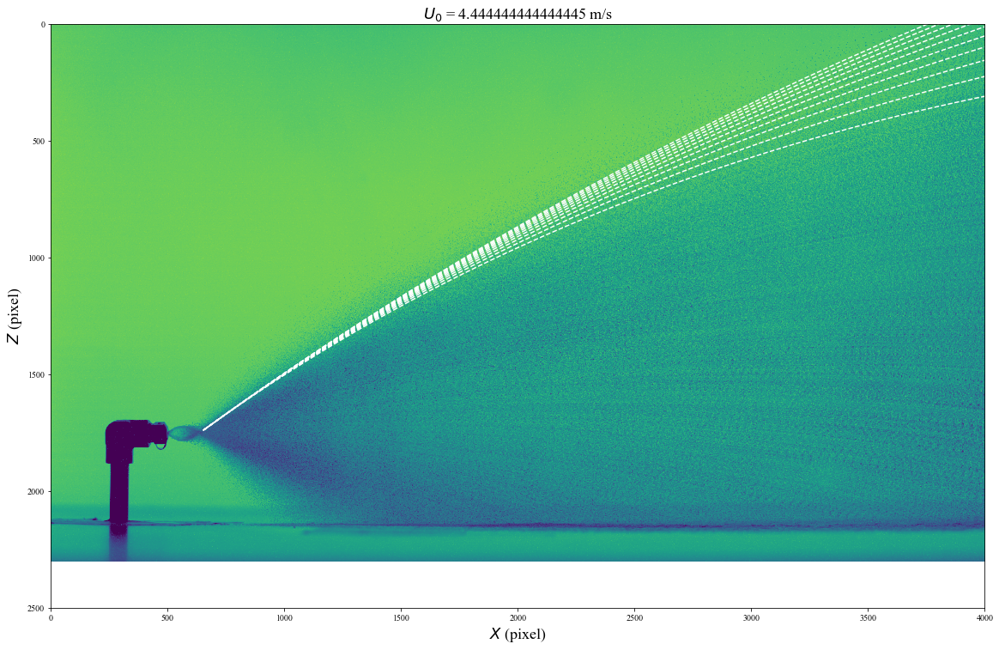

In [157]:
key = 40
fu = 1/9
xc = data[key]['x0']
yc = data[key]['y0']

k = 'near'
Fr = fit[key]['Fr']*1.25#0.71/2.38/10#2*2.38/6.67
eps = 0
vreal = fit[key]['vr']*1.2 #initial velocity, in unit of U0
U0 = key*fu#fit[key]['U0']
v1 = vreal/U0*1.2
print(v1)
eps = 0.25
g = 9.81
H = 0.05
Fr0 = U0/np.sqrt(g*H)

#thetalist = np.linspace(-np.pi/4,3*np.pi/8,15)
#vlist = v1*np.ones(len(thetalist))

vlist = np.linspace(v1*(1-eps),v1*(1+eps),10)
thetalist = np.pi/5*np.ones(len(vlist))#np.linspace(-np.pi/4,3*np.pi/8,15)

Xlist,X,Z = traj_beam(thetalist,vlist,Fr,Fr0,display=False,N=10**5,H=H)

plt.figure(1,figsize=(15*650/500,15))
plt.imshow(data[key][k])

if k=='near':
    for x,z in zip(X,Z):
        plt.plot(x*Fr0**2*H/fx*10**3+xc,-z*Fr0**2*H/fx*10**3+yc+50/fx,'w--')
    plt.axis([0,4000,2500,0])

#plt.axis('equal')
if k=='far':
    xf = -1491/fx#distance in pix #900/fx
    for x,z in zip(X,Z):
        plt.plot(x*Fr0**2*H/fx*10**3+xc+xf,-z*Fr0**2*H/fx*10**3+yc+50/fx,'w--')
    plt.axis([0,4000,2500,0])

figs = {}
figs.update(graphes.legende('$X$ (pixel)','$Z$ (pixel)','$U_0$ = '+str(U0)+' m/s'))
#graphes.save_figs(figs,savedir=savefolder,frmt='png',prefix = 'fit_U0'+str(int(key*100)))

In [129]:
def transport(y,t,Fr):
    vx,vz = y
    a = np.sqrt(((vx-1)**2+vz**2))
    dydt = [-Fr**2*a*(vx-1),-Fr**2*a*vz-1]
    return dydt

def find_zero(x,z):
    i = np.argmin(np.abs(z))
    return x[i],i

def traj(y,r0,dt):
    X = np.cumsum(y,axis=0)*dt
    x = X[:,0]+r0[0]
    z = X[:,1]+r0[1]
    return x,z

def traj_beam(thetalist,vlist,Fr,Fr0,display=False,N=10**5,H=0.05):
    Xlist = []
    X = []
    Z = []
    for j,(theta,v0) in enumerate(zip(thetalist,vlist)):
        y0 = [v0*np.cos(theta),v0*np.sin(theta)]#initial velocity
        t = np.linspace(0,100,N+1)
        dt = t[1]-t[0]
        sol = inte.odeint(transport, y0, t, args=(Fr,))#c0 replaced by 0
        
        z0 = 1/Fr0**2
        x,z = traj(sol,[0,z0],dt)#get the trajectory from the velocity 
        xm,i = find_zero(x,z)
        
        if j==0:
            print(theta,t[i])

        X.append(x[:i])
        Z.append(z[:i])
        
        if display:
            plt.plot(x[:i]*Fr0**2*H,z[:i]*Fr0**2*H)
            graphes.legende('$x$ (m)','$z$ (m)','')
        Xlist.append(xm)
    return np.asarray(Xlist),X,Z

def distribution(thetalist,Xlist,sigma,display=False):#starting from a distribution of angle, what is the distribution of time of flight ?
    rho = 1/np.sqrt((2*np.pi*sigma**2))*np.exp(-thetalist**2/(2*sigma**2))
    dtheta = thetalist[1]-thetalist[0]
    if display:
        plt.semilogy(thetalist,rho,'ko')

    dTh = dtheta/np.diff(Xlist)
    rhom = (rho[1:]+rho[:-1])/2
    rho_x = rhom*dTh
    xm = (Xlist[1:]+Xlist[:-1])/2
    thetam = (thetalist[1:]+thetalist[:-1])/2
    if display:
        plt.figure()
        plt.semilogy(xm,rho_x,'ro')
    return xm,rho_x

def transport_noise(y,t,fun,Fr,alpha):#alpha = H/l, where l is the friction length
    vx,vz = y
    a = np.sqrt(((vx-Fr)**2+vz**2))
    dydt = [-alpha*a*(vx-Fr)+fun(t)[0],-alpha*a*vz-1+fun(t)[1]]
    return dydt

def transport_noise_real(y,t,fun,Fr,alpha):#alpha = H/l, where l is the friction length
    vx,vz = y
    a = np.sqrt(((vx-Fr*(1+fun(t)[0]))**2+(vz-Fr*fun(t)[1])**2))
    dydt = [-alpha*a*(vx-Fr*(1+fun(t)[0])),-alpha*a*(vz-Fr*fun(t)[1])-1]
    return dydt

#create the noise
def make_noise_2d(t,sigma,nc):
    n = len(t)
    a = np.random.multivariate_normal([0.,0.],[[sigma**2,0],[0,sigma**2]], size=n+nc,)
    b = np.cumsum(a,axis=0)
    c = b[nc:,:]-b[:-nc,:]
    c = c/np.sqrt(nc)
    
    cf1 = interp.interp1d(t, c[:,0], kind='cubic')
    cf2 = interp.interp1d(t, c[:,1], kind='cubic')
    cfun = lambda x:(cf1(x),cf2(x))
    return c,cfun

def traj_noise(theta,Fr,Fr0,sigma,nc,display=False,N=10**5):
    y0 = [v0*np.cos(theta),v0*np.sin(theta)]#initial velocity
    t = np.linspace(0,10,N+1)
    dt = t[1]-t[0]
    tnoise = np.linspace(0,11,int(N*1.1+1))
    
    c,cfun = make_noise_2d(tnoise,sigma,nc)

    dt = t[1]-t[0]
    sol = inte.odeint(transport_noise_real, y0, t,args=(cfun,Fr),hmin=dt)#c0 replaced by 0
    x,z = traj(sol,[0,1],dt)#get the trajectory from the velocity 
    xm,i = find_zero(x,z)
        
    print(theta,t[i])

    if display:
        plt.plot(x[:i],z[:i])
    return x[:i],z[:i],xm

def traj_beam_noise(thetalist,*args,**kwargs):
    Xlist = []
    for j,theta in enumerate(thetalist):
        x,z,xm = traj_noise(theta,args,kwargs)
        Xlist.append(xm)
    return np.asarray(Xlist)

In [162]:
data[key][k].shape

(2304, 4096)

In [ ]:
from mpl_toolkits.mplot3d import Axes3D  
# Axes3D import has side effects, it enables using projection='3d' in add_subplot

k = 'near'
nx,ny = data[key][k].shape
x0,y0 = data[key]['x0'],data[key]['y0']
x = np.linspace(-x0,-x0+ny-1,nx)
y = np.linspace(-y0,-y0+nx-1,ny)
Y,X = np.meshgrid(y,x)

print(X.shape)
print(data[key][k].shape)

fig = plt.figure()
ax = fig.add_subplot(111)#, projection='3d')
ax.pcolormesh(Y,X,data[key][k])
#axis()
#plt.figure(1,figsize=(15*650/500,15))
#plt.imshow()

k = 'far'

#zs = np.array(fun(np.ravel(X), np.ravel(Y)))
#Z = zs.reshape(X.shape)
#ax.plot_surface(X, Y, Z)

In [46]:
50*85/93

45.69892473118279

['/Users/stephane/Documents/Collaborations/LDeike/Transport_droplets/Processing/Fig_U0ms.png', '/Users/stephane/Documents/Collaborations/LDeike/Transport_droplets/Processing/Fig_U238ms.png', '/Users/stephane/Documents/Collaborations/LDeike/Transport_droplets/Processing/Fig_U667ms.png', '/Users/stephane/Documents/Collaborations/LDeike/Transport_droplets/Processing/w_vs_d_U67dmps.png']


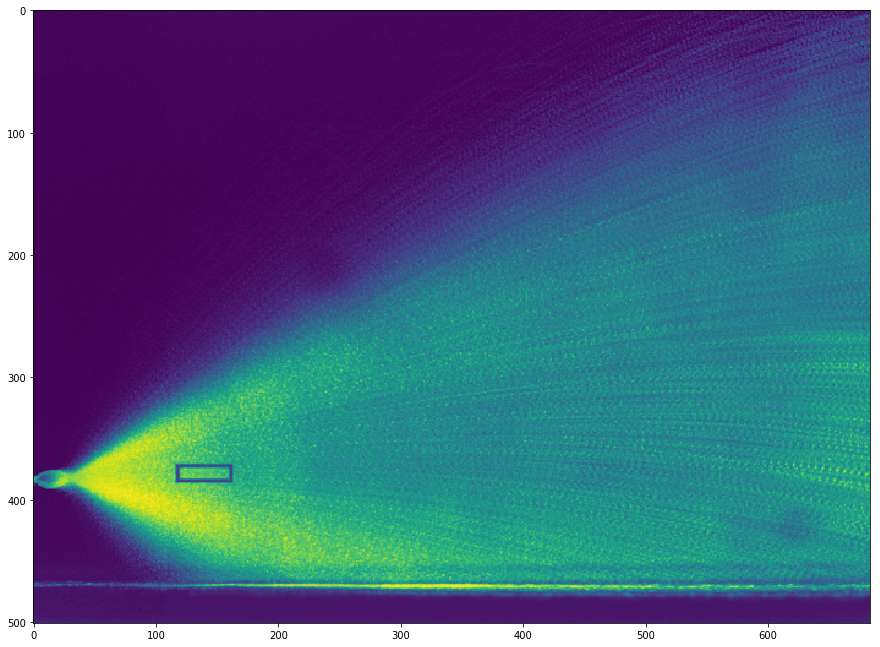

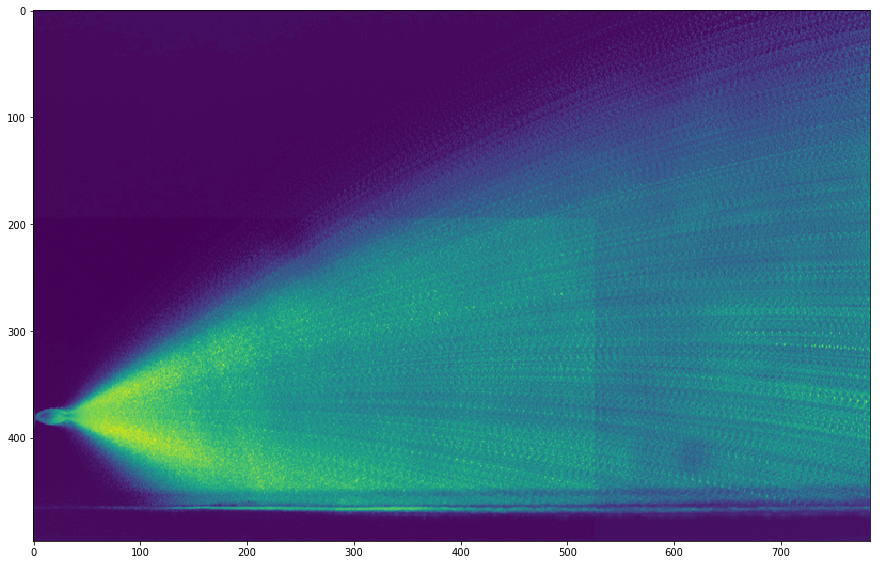

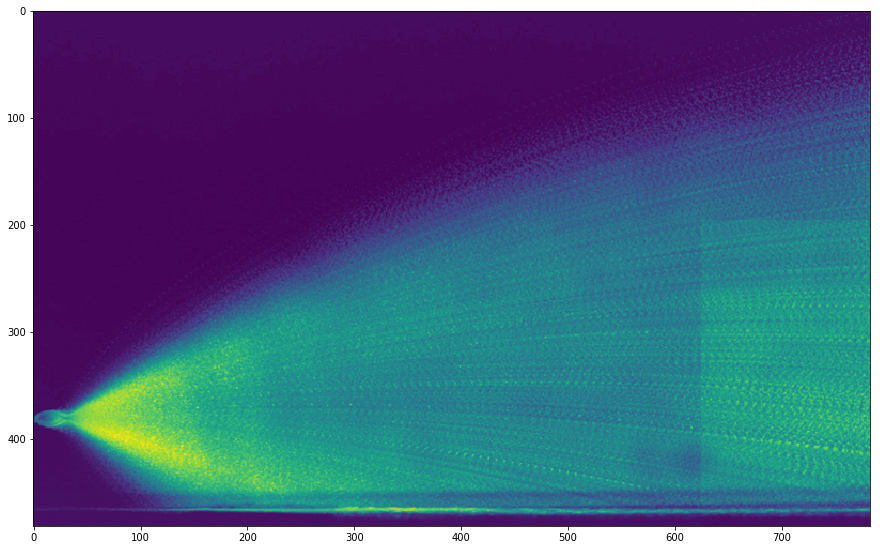

In [91]:
filelist = glob.glob(datefolder+'*.png')
print(filelist)
# Save image in set directory
# Read RGB image
#fx0 = 50/93
fx = 50/85
#fx2 = 50/85

I={}
for filename in filelist[:3]:
    U0 = int(filename.split('Fig_U')[1].split('ms')[0])/100
    I[U0]={}
    I[U0]['im'] = cv2.imread(filename)[:,:,0]
    I[U0]['fx'] = fx
    if U0==0:
        x,y = [32,383]
    else:
        x,y = [32,380]
    I[U0]['x0'] = x
    I[U0]['y0'] = y
    
# Output img with window name as 'image'
    plt.figure(figsize=(15,15))
    plt.imshow(I[U0]['im'])

In [258]:
yc

380

In [43]:
I.keys()

dict_keys([0.0, 2.38, 6.67])

In [45]:
I[0.0].keys()

dict_keys(['im', 'fx', 'x0', 'y0'])

In [96]:
x=20
for key in I.keys():
    xc,yc = I[key]['x0'],I[key]['y0']
    I0 = np.mean(I[key]['im'][yc-10:yc+10,x+xc])

    print(I0)
    I[key]['I0'] = I0
Iref = I0

235.5
160.9
156.5


In [105]:
display = False

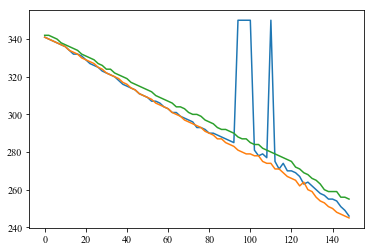

In [314]:
def compute_pdf(I,a,data,ymin = 350,ymax = 50):
    b = 5
    xlist = np.arange(0,150,2)
    
    data[a] = {}
    for key in I.keys():
        data[a][key]={}
        data[a][key]['yM']=[]
        data[a][key]['ym']=[]
        data[a][key]['x'] = xlist
    for x in xlist:
        for key in I.keys():
            xc,yc = I[key]['x0'],I[key]['y0']

            profile = np.mean(I[key]['im'][yc-ymin:yc+ymax,x+xc-b:x+xc+b+1],axis=1)/I[key]['I0']*Iref
            #print(len(profile))
            #plt.plot(profile)
            ymax = np.argmax(profile[:yc])
            Imax = np.mean(profile[ymax-10:ymax+10])

            y0 = np.argmin(np.abs(profile[ymax:-1]-Imax*a))+ymax
            y1 = np.argmin(np.abs(profile[0:ymax]-Imax*a))
        
            data[a][key]['yM'].append(y0)
            data[a][key]['ym'].append(y1)
    
    for key in I.keys():
        data[a][key]['yM']=np.asarray(data[a][key]['yM'])
        data[a][key]['ym']=np.asarray(data[a][key]['ym'])

    return data

a = 0.5
data = {}
data[a]={}
data['yM'] = []
data['ym'] = []
data['x'] = []

data = compute_pdf(I,a,data)
for key in [0.0,2.38,6.67]:
    plt.plot(data[0.5][key]['x'],data[0.5][key]['ym'])

In [312]:
alist

array([0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2 , 0.21, 0.22,
       0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3 , 0.31, 0.32, 0.33,
       0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4 , 0.41, 0.42, 0.43, 0.44,
       0.45, 0.46, 0.47, 0.48, 0.49, 0.5 , 0.51, 0.52, 0.53, 0.54, 0.55,
       0.56, 0.57, 0.58, 0.59, 0.6 , 0.61, 0.62, 0.63, 0.64])

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/matplotlib/figure.py:98: MatplotlibDeprecationWarning: 
Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  "Adding an axes using the same arguments as a previous axes "


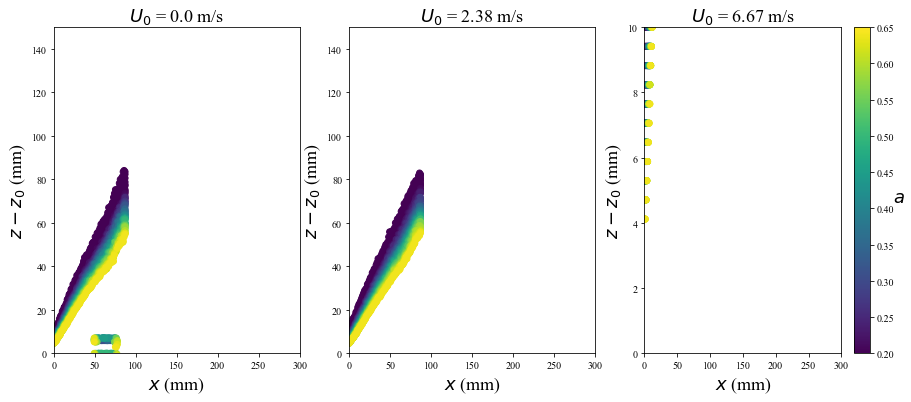

In [315]:
alist = np.arange(0.12,0.65,0.01)

cm = plt.cm.get_cmap('viridis')

plt.subplots(1,3,figsize=(15,6))

for a in alist:
    data = compute_pdf(I,a,data)
    for key in [0.0,2.38,6.67]:
        n = len(data[a][key]['x'])
        if key == 0.0:
            plt.subplot(1,3,1)
        if key == 2.38:
            plt.subplot(1,3,2)
        if key == 6.67:
            plt.subplot(1,3,3)
            
        x = data[a][key]['x']*fx
        y = (350-data[a][key]['ym'])*fx
        sc = plt.scatter(x,y,c=a*np.ones(n), vmin=0.2, vmax=0.65, cmap=cm)
        
        p = np.polyfit(x,y,2)
        data[a][key]['p'] = p

plt.subplot(1,3,1)
graphes.legende('$x$ (mm)','$z-z_0$ (mm)','$U_0$ = 0.0 m/s')
plt.axis([0,300,0,150])

plt.subplot(1,3,2)
graphes.legende('$x$ (mm)','$z-z_0$ (mm)','$U_0$ = 2.38 m/s')
plt.axis([0,300,0,150])

plt.subplot(1,3,3)
graphes.legende('$x$ (mm)','$z-z_0$ (mm)','$U_0$ = 6.67 m/s')
plt.axis([0,300,0,10])

cbar = plt.colorbar(sc)#,ticks=[-2,-1,0,1])
#cbar.ax.set_yticklabels(['$10^{-2}$','$10^{-1}$','$10^0$','$10^1$'])  
cbar.set_label('$a$', rotation=0,fontsize=18)

In [300]:
data[a][key].keys()

dict_keys(['yM', 'ym', 'x', 'p'])

In [308]:
data.keys()

dict_keys([0.5, 'yM', 'ym', 'x', 0.12, 0.13, 0.14, 0.15000000000000002, 0.16000000000000003, 0.17000000000000004, 0.18000000000000005, 0.19000000000000006, 0.20000000000000007, 0.21000000000000008, 0.22000000000000008, 0.2300000000000001, 0.2400000000000001, 0.2500000000000001, 0.2600000000000001, 0.27000000000000013, 0.28000000000000014, 0.29000000000000015, 0.30000000000000016, 0.31000000000000016, 0.3200000000000002, 0.3300000000000002, 0.3400000000000002, 0.3500000000000002, 0.3600000000000002, 0.3700000000000002, 0.3800000000000002, 0.39000000000000024, 0.40000000000000024, 0.41000000000000025, 0.42000000000000026, 0.43000000000000027, 0.4400000000000003, 0.4500000000000003, 0.4600000000000003, 0.4700000000000003, 0.4800000000000003, 0.4900000000000003, 0.5000000000000003, 0.5100000000000003, 0.5200000000000004, 0.5300000000000004, 0.5400000000000004, 0.5500000000000004, 0.5600000000000004, 0.5700000000000004, 0.5800000000000004, 0.5900000000000004, 0.6000000000000004, 0.610000000

In [311]:
data[0.5][2.38].keys()#['p'][0]

dict_keys(['yM', 'ym', 'x'])

In [ ]:
np.polyval

In [292]:
alist

array([0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2 , 0.21, 0.22,
       0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3 , 0.31, 0.32, 0.33,
       0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4 , 0.41, 0.42, 0.43, 0.44,
       0.45, 0.46, 0.47, 0.48, 0.49, 0.5 , 0.51, 0.52, 0.53, 0.54, 0.55,
       0.56, 0.57, 0.58, 0.59, 0.6 , 0.61, 0.62, 0.63, 0.64])

In [313]:
print(a)

for key in data.keys():
    print(key,data[key][2.38]['p'][0])

0.6400000000000005


KeyError: 'p'

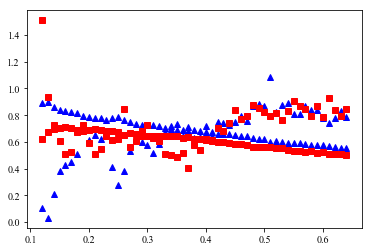

In [295]:
keys = [2.38,6.67]
colors = {0.0:'go',2.38:'b^',6.67:'rs'}

for key in keys:
    for a in alist:
        
        #p = data[a][key]['p']
        #2*p[0]+p[1]
        #pente = np.polyval(dp,data[a][key]['x'][0])
        
        plt.plot(a,data[a][key]['p'][1],colors[key])
        plt.plot(a,2*data[a][key]['p'][0]*500+data[a][key]['p'][1],colors[key])

#        plt.plot(data[a][key]['p'][1],data[a][key]['p'][0],colors[key])

        #else:
        #    plt.plot(a,data[a][key]['p'][0],'go')

        #plt.plot(data[a][key]['p'][1],data[a][key]['p'][0],'ko')

In [178]:
a = 0.5
b = 5
for key in I.keys():
    I[key]['yM'] = []
    I[key]['ym'] = []
    I[key]['x'] = []

for x in xlist:
    for key in I.keys():
        xc,yc = I[key]['x0'],I[key]['y0']

        profile = np.mean(I[key]['im'][yc-350:yc+350,x+xc-b:x+xc+b+1],axis=1)/I[key]['I0']*Iref
        #print(profile)
    #print(profile)
        ymax = np.argmax(profile)
#        print(ymax)
        Imax = np.mean(profile[ymax-10:ymax+10])

        y0 = np.argmin(np.abs(profile[ymax:-1]-Imax*a))+ymax
        y1 = np.argmin(np.abs(profile[0:ymax]-Imax*a))
        
        I[key]['x'].append(x)
        I[key]['yM'].append(y0)
        I[key]['ym'].append(y1)
        
        if display:
            plt.plot(profile)
            plt.plot(y0,Imax/2,'r<')
            plt.plot(y1,Imax/2,'r>')
    
for key in I.keys():
    for k in ['x','yM','ym']:
        I[key][k]=np.asarray(I[key][k])
#    print(I0)
Iref = I0

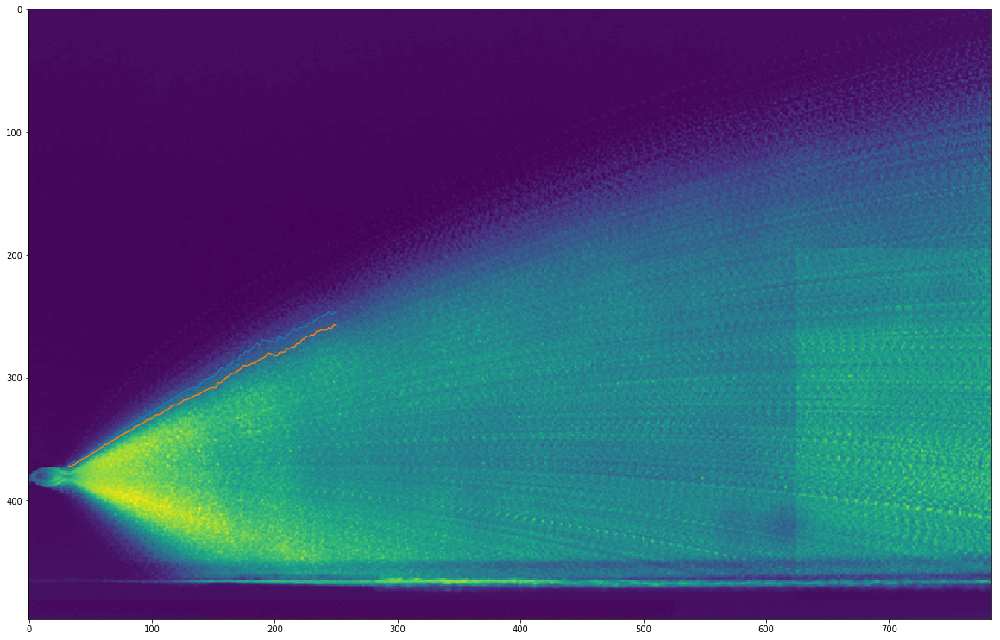

In [179]:
plt.figure(figsize=(20,20))
for key in [2.38,6.67]:
    plt.imshow(I[key]['im'])
    plt.plot(I[key]['x']+I[key]['x0'],I[key]['ym']+I[key]['y0']-350)
    
    Xt = I[key]['x']*fx
    Yt = I[key]['y0']-I[key]['ym']*fx

[-9.37087190e-04  7.10064638e-01  1.78231397e+02]
[-6.18692907e-04  6.13055554e-01  1.78286365e+02]


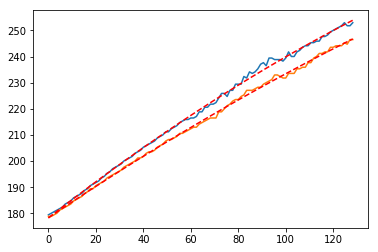

In [180]:
for key in [2.38,6.67]:
    Xt = I[key]['x']*fx
    Yt = I[key]['y0']-I[key]['ym']*fx

    p = np.polyfit(Xt,Yt,2)
    Yth = np.polyval(p,Xt)
    print(p)
    
    plt.plot(Xt,Yt)
    plt.plot(Xt,Yth,'r--')

In [57]:
Iref

44.41493055555556

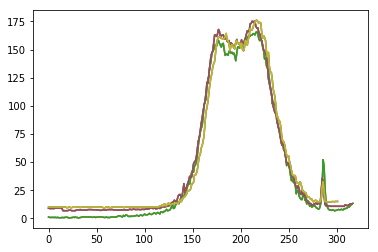

In [83]:
x = 
b = 3
for key in I.keys():
    x0,y0 = I[key]['x0'],I[key]['y0']
    profile = np.mean(I[key]['im'][y0-200:y0+150,x+x0-b:x+x0+b+1],axis=1)/I[key]['I0']*Iref
    plt.plot(profile)

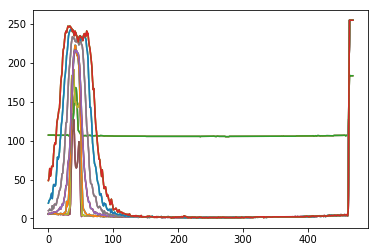

In [23]:
b = 3 
xlist = np.arange(120,200,10)
for x in xlist:
    plt.plot(np.mean(img[500:30:-1,x-b:x+b+1],axis=1))

In [17]:
# Transport equation, dimensionless with free fall (travelled distance of order 1 for Fr->0)
# v_x'(t) = -1/l*|v-U0e_x|(v_x-U0) + Fx
# v_z'(t) = -1/l*|v-U0e_x|v_z - g + Fz
#t_c = U0/g
#V -> V/U0
#L -> L/(l*Fr^2)
#L = H, -> z(0)= 1
#Fr = U0/sqrt(gl)
# v_x'(t) = -H/l*|v-Fre_x|(v_x-Fr) + Fx
# v_z'(t) = -H/l*|v-Fr e_x|v_z - 1 + Fz
#t_c = U0/g
#L = H, -> z(0)= H/(l*Fr^2)
#with H/l ~ 0.1
#integrate to get x and z, solve until z=0 is reached

# omega'(t) = -b*omega(t) - c*sin(theta(t))
def transport(y,t,Fr,alpha):#alpha = H/l, where l is the friction length
    vx,vz = y
    a = np.sqrt(((vx-Fr)**2+vz**2))
    dydt = [-alpha*a*(vx-Fr),-alpha*a*vz-1]
    return dydt

# Phi(x) = w0^2(-c0 x+x^2-beta/2 x^4)
# dPhi/dx = 0
#x(1-beta*x^2)=c0
#-x^3+x = c0

In [7]:
# Transport equation, dimensionless with free fall (travelled distance of order 1 for Fr->0)
# v_x'(t) = -1/l*|v-U0e_x|(v_x-U0) + Fx
# v_z'(t) = -1/l*|v-U0e_x|v_z - g + Fz
#t_c = U0/g
#V -> V/U0
#L -> L/(l*Fr^2)
#L = H, -> z(0)= 1
#Fr = U0/sqrt(gl)
# v_x'(t) = -H/l*|v-Fre_x|(v_x-Fr) + Fx
# v_z'(t) = -H/l*|v-Fr e_x|v_z - 1 + Fz
#t_c = U0/g
#L = H, -> z(0)= H/(l*Fr^2)
#with H/l ~ 0.1
#integrate to get x and z, solve until z=0 is reached

# omega'(t) = -b*omega(t) - c*sin(theta(t))
def transport_noise(y,t,fun,Fr,alpha):#alpha = H/l, where l is the friction length
    vx,vz = y
    a = np.sqrt(((vx-Fr)**2+vz**2))
    dydt = [-alpha*a*(vx-Fr)+fun(t)[0],-alpha*a*vz-1+fun(t)[1]]
    return dydt

def transport_noise_real(y,t,fun,Fr,alpha):#alpha = H/l, where l is the friction length
    vx,vz = y
    a = np.sqrt(((vx-Fr*(1+fun(t)[0]))**2+(vz-Fr*fun(t)[1])**2))
    dydt = [-alpha*a*(vx-Fr*(1+fun(t)[0])),-alpha*a*(vz-Fr*fun(t)[1])-1]
    return dydt


# Phi(x) = w0^2(-c0 x+x^2-beta/2 x^4)
# dPhi/dx = 0
#x(1-beta*x^2)=c0
#-x^3+x = c0

In [8]:
# Transport equation, dimensionless with wind speed (Equilibrium speed V ~ 1)
# v_x'(t) = -1/l*|v-U0e_x|(v_x-U0) + Fx
# v_z'(t) = -1/l*|v-U0e_x|v_z - g + Fz
#V0 = U0
#t0 = U0/g
#l0 = U0^2/g
#L = H, -> z(0)= H/L*Fr^(-2)
#Fr = U0/sqrt(gl)
# v_x'(t) = -Fr**2|v-e_x|(v_x-e_x) + Fx
# v_z'(t) = -Fr**2|v-1|v_z - 1 + Fz
#t_c = U0/g
#L = H, -> z(0)= H/(l*Fr^2)
#with H/l ~ 0.1
#integrate to get x and z, solve until z=0 is reached

# omega'(t) = -b*omega(t) - c*sin(theta(t))
def transport(y,t,Fr):
    vx,vz = y
    a = np.sqrt(((vx-1)**2+vz**2))
    dydt = [-Fr**2*a*(vx-1),-Fr**2*a*vz-1]
    return dydt

# Phi(x) = w0^2(-c0 x+x^2-beta/2 x^4)
# dPhi/dx = 0
#x(1-beta*x^2)=c0
#-x^3+x = c0

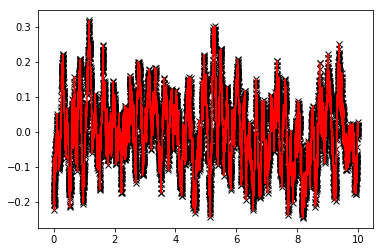

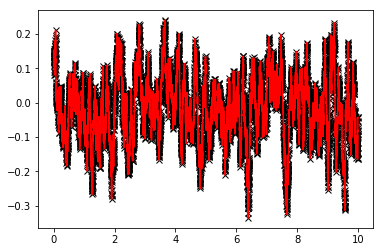

In [9]:
N=10**4
t = np.linspace(0,10,N+1)
sigma = 0.1
nc = 10**2

#create the noise
def make_noise_2d(t,sigma,nc):
    n = len(t)
    a = np.random.multivariate_normal([0.,0.],[[sigma**2,0],[0,sigma**2]], size=n+nc,)
    b = np.cumsum(a,axis=0)
    c = b[nc:,:]-b[:-nc,:]
    c = c/np.sqrt(nc)
    
    cf1 = interp.interp1d(t, c[:,0], kind='cubic')
    cf2 = interp.interp1d(t, c[:,1], kind='cubic')
    cfun = lambda x:(cf1(x),cf2(x))
    return c,cfun

c,cfun = make_noise_2d(t,sigma,nc)

for i in range(2):
    plt.figure(i+1)
    plt.plot(t,c[:,i],'kx')
    plt.plot(t,cfun(t)[i],'r-')

In [10]:
def find_zero(x,z):
    i = np.argmin(np.abs(z))
    return x[i],i

def traj(y,r0,dt):
    X = np.cumsum(y,axis=0)*dt
    x = X[:,0]+r0[0]
    z = X[:,1]+r0[1]
    return x,z

In [123]:
def traj_beam(thetalist,vlist,Fr,Fr0,display=False,N=10**5):
    Xlist = []
    for j,theta,v0 in enumerate(zip(thetalist,vlist)):
        y0 = [v0*np.cos(theta),v0*np.sin(theta)]#initial velocity
        t = np.linspace(0,10,N+1)
        dt = t[1]-t[0]
        sol = inte.odeint(transport, y0, t, args=(Fr,alpha))#c0 replaced by 0
        
        z0 = 1/Fr0**2
        x,z = traj(sol,[0,z0],dt)#get the trajectory from the velocity 
        xm,i = find_zero(x,z)
        
        if j==0:
            print(theta,t[i])

        if display:
            plt.plot(x[:i],z[:i])
        Xlist.append(xm)
    return np.asarray(Xlist)

In [12]:
def traj_noise(theta,Fr,alpha,sigma,nc,display=False,N=10**5):
    y0 = [v0*np.cos(theta),v0*np.sin(theta)]#initial velocity
    t = np.linspace(0,10,N+1)
    dt = t[1]-t[0]
    tnoise = np.linspace(0,11,int(N*1.1+1))
    
    c,cfun = make_noise_2d(tnoise,sigma,nc)

    dt = t[1]-t[0]
    sol = inte.odeint(transport_noise_real, y0, t,args=(cfun,Fr,alpha),hmin=dt)#c0 replaced by 0
    x,z = traj(sol,[0,1],dt)#get the trajectory from the velocity 
    xm,i = find_zero(x,z)
        
    print(theta,t[i])

    if display:
        plt.plot(x[:i],z[:i])
    return x[:i],z[:i],xm

In [13]:
def traj_beam_noise(thetalist,*args,**kwargs):
    Xlist = []
    for j,theta in enumerate(thetalist):
        x,z,xm = traj_noise(theta,args,kwargs)
        Xlist.append(xm)
    return np.asarray(Xlist)

In [14]:
def distribution(thetalist,Xlist,sigma,display=False):#starting from a distribution of angle, what is the distribution of time of flight ?
    rho = 1/np.sqrt((2*np.pi*sigma**2))*np.exp(-thetalist**2/(2*sigma**2))
    dtheta = thetalist[1]-thetalist[0]
    if display:
        plt.semilogy(thetalist,rho,'ko')

    dTh = dtheta/np.diff(Xlist)
    rhom = (rho[1:]+rho[:-1])/2
    rho_x = rhom*dTh
    xm = (Xlist[1:]+Xlist[:-1])/2
    thetam = (thetalist[1:]+thetalist[:-1])/2
    if display:
        plt.figure()
        plt.semilogy(xm,rho_x,'ro')
    return xm,rho_x

In [30]:
data = {}

In [68]:
Xlist.shape

(100,)

-1.1780972450961724 0.0119


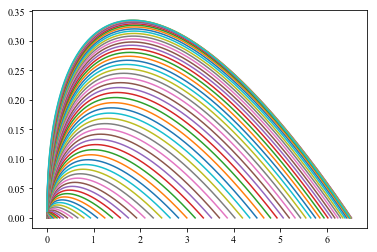

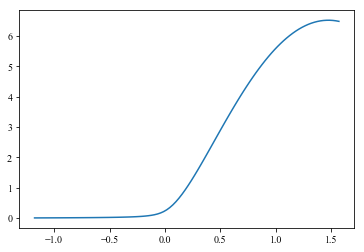

In [71]:
Fr = 10
Xlist = traj_beam(thetalist,Fr,Fr0,display=True,N=10**5)

plt.figure(2)
plt.plot(thetalist,Xlist)
#plt.figure(2)
#xm,rho_x = distribution(thetalist,Xlist,sigma)
#plt.scatter(xm/Fr,rho_x,marker='o',c=z[:-1], vmin=-2, vmax=1, cmap=cm)         
#plt.yscale('log')     

8.567058737562386
-1.1780972450961724 0.0328


/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/matplotlib/axes/_base.py:3099: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=100.0, right=100.0
  self.set_xlim(upper, lower, auto=None)


-1.1780972450961724 0.032100000000000004
-1.1780972450961724 0.0315
-1.1780972450961724 0.031100000000000003
-1.1780972450961724 0.0307
-1.1780972450961724 0.0303
-1.1780972450961724 0.030100000000000002
-1.1780972450961724 0.0298
-1.1780972450961724 0.0296
-1.1780972450961724 0.029500000000000002
-1.1780972450961724 0.029300000000000003
-1.1780972450961724 0.0292
-1.1780972450961724 0.0291
-1.1780972450961724 0.029
-1.1780972450961724 0.028900000000000002
-1.1780972450961724 0.028900000000000002
-1.1780972450961724 0.028800000000000003
-1.1780972450961724 0.028800000000000003
-1.1780972450961724 0.0287
-1.1780972450961724 0.0287
-1.1780972450961724 0.0287
-1.1780972450961724 0.0286
-1.1780972450961724 0.0286
-1.1780972450961724 0.0286
-1.1780972450961724 0.0286
-1.1780972450961724 0.0286
-1.1780972450961724 0.0286
-1.1780972450961724 0.0286
-1.1780972450961724 0.0286
-1.1780972450961724 0.0285


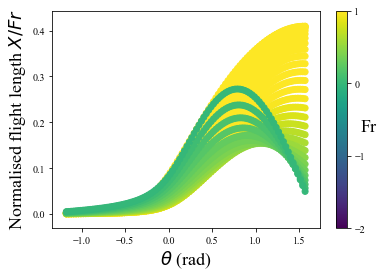

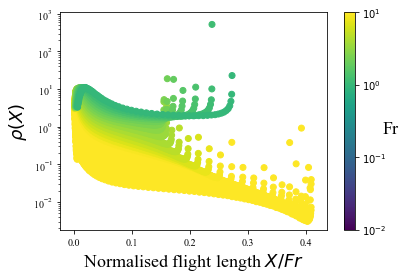

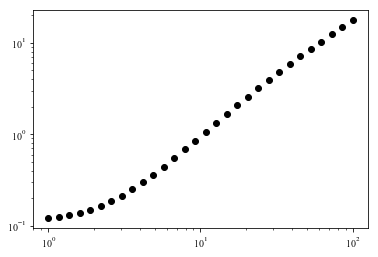

In [102]:
data = {}
Fr = 0.01
sigma = 0.5
v0 = 0.5 #initial velocity, in unit of U0

H = 0.05#height in m
U0 = 6#.66
g = 9.81
Fr0 = U0/np.sqrt(g*H)
print(Fr0)

cm = plt.cm.get_cmap('viridis')

eps = 0
for Fr in np.logspace(2,0,30):
    thetalist = np.linspace(-3*np.pi/8,np.pi/2-eps,100)
    Xlist = traj_beam(thetalist,Fr,Fr0,display=False,N=10**5)
    z=np.log10(Fr)*np.ones(len(thetalist))#for colorbar
    Lmean = np.mean(Xlist)
    Lmin = np.min(Xlist)
    Lmax = np.max(Xlist)
    
    plt.figure(1)
    sc = plt.scatter(thetalist,Xlist/Fr,marker='o',c=z, vmin=-2, vmax=1, cmap=cm)
    
    plt.figure(2)
    xm,rho_x = distribution(thetalist,Xlist,sigma)
    plt.scatter(xm/Fr,rho_x,marker='o',c=z[:-1], vmin=-2, vmax=1, cmap=cm)         
    plt.yscale('log')             

    plt.figure(3)
    plt.loglog(Fr,Lmean,'ko')
    
    # create a dictionnary
    for key in ['Fr','Lmean','Lmin','Lmax','thetalist','Xlist','xm','rho_x']:
        if key not in data.keys():
            data[key]=[]
        data[key].append(locals()[key])          

for key in data.keys():
    data[key] = np.asarray(data[key])
    
figs = {}
plt.figure(1)
cbar = plt.colorbar(sc,ticks=[-2,-1,0,1])
cbar.ax.set_yticklabels(['$10^{-2}$','$10^{-1}$','$10^0$','$10^1$'])  
cbar.set_label('Fr', rotation=0,fontsize=18)
figs.update(graphes.legende(r'$\theta$ (rad)','Normalised flight length $X/Fr$',''))
#plt.axis([-1.3,1.3,0,2])

plt.figure(2)
cbar = plt.colorbar(sc,ticks=[-2,-1,0,1])
cbar.ax.set_yticklabels(['$10^{-2}$','$10^{-1}$','$10^0$','$10^1$'])  
cbar.set_label('Fr', rotation=0,fontsize=18)
figs.update(graphes.legende(r'Normalised flight length $X/Fr$',r'$\rho(X)$',''))

#plt.figure(3)
#figs.update(graphes.legende('','',''))
graphes.save_figs(figs,savedir=savefolder,suffix='Fr_all')

In [103]:
for key in data.keys():
    data[key] = np.asarray(data[key])

In [101]:
Fr0

8.567058737562386

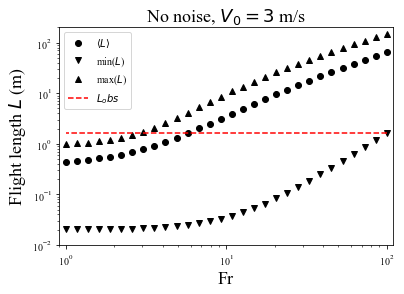

<Figure size 432x288 with 0 Axes>

In [105]:
Frs = data['Fr']

plt.loglog(Frs,data['Lmean']*Fr0**2*H,'ko')
plt.loglog(Frs,data['Lmin']*Fr0**2*H,'kv')
plt.loglog(Frs,data['Lmax']*Fr0**2*H,'k^')
plt.loglog(Frs,1.6*np.ones(len(Frs)),'r--')
plt.legend([r'$\langle L \rangle$',r'min($L$)',r'max($L$)','$L_obs$'])
plt.axis([0.9,110,0.01,200])
figs.update(graphes.legende('Fr','Flight length $L$ (m)','No noise, $V_0 = 3$ m/s'))
graphes.save_figs(figs,savedir=savefolder,prefix = 'no_noise_')

-1.1780972450961724 0.7914
-1.1780972450961724 0.7913
-1.1780972450961724 0.7912
-1.1780972450961724 0.7909
-1.1780972450961724 0.7905000000000001
-1.1780972450961724 0.7903
-1.1780972450961724 0.7933
-1.1780972450961724 0.8095
-1.1780972450961724 0.8558
-1.1780972450961724 0.9583


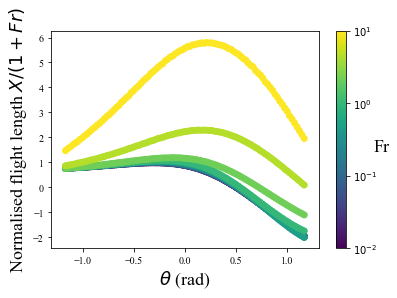

In [130]:
Fr = 0.01
H = 0.1
l = 1
alpha = H/l

cm = plt.cm.get_cmap('viridis')

for Fr in np.logspace(-2,1,10):
    thetalist = np.linspace(-3*np.pi/8,3*np.pi/8,100)
    Xlist = traj_beam(thetalist,Fr,alpha,display=False)
    
    dtheta = thetalist[1]-thetalist[0]
    df = np.diff(Xlist)*1./dtheta
    thetam = (thetalist[1:]+thetalist[:-1])/2
    sc = plt.scatter(thetam,df,marker='o',c=np.log10(Fr)*np.ones(len(thetam)), vmin=-2, vmax=1, cmap=cm)
    
cbar = plt.colorbar(sc,ticks=[-2,-1,0,1])
cbar.ax.set_yticklabels(['$10^{-2}$','$10^{-1}$','$10^0$','$10^1$'])  
cbar.set_label('Fr', rotation=0,fontsize=18)
figs.update(graphes.legende(r'$\theta$ (rad)','Normalised flight length $X/(1+Fr)$',''))
#plt.axis([-1.3,1.3,0,2])

In [227]:
theta

1.1780972450961724

0.5 0.0
0.5 0.0
0.5 10.0
0.5 0.0
0.5 0.0
0.5 0.0
0.5 7.2700000000000005
0.5 0.0
0.5 1.8800000000000001
0.5 2.16
figure already exists
0.09680204925668158


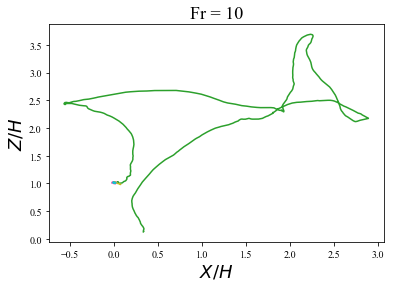

In [251]:
Fr = 10
H = 0.1
l = 1
alpha = H/l
sigma = 0.1
nc = 10**2
theta = 0.5

Xlist = []
for i in range(10):
    x,z,xm = traj_noise(theta,Fr,alpha,sigma,nc,display=False,N=10**3)
    plt.plot(x,z)
    Xlist.append(xm)
    
figs = {}
figs.update(graphes.legende(r'$X/H$',r'$Z/H$','Fr = '+str(Fr)))
graphes.save_figs(figs,savedir=savefolder,prefix='noise_real',suffix='Fr_'+str(Fr)+'_theta'+str(round(theta*100))+'c')
print(np.std(Xlist))

0.9999999973751017


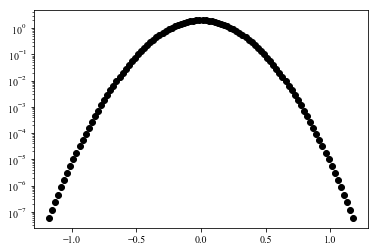

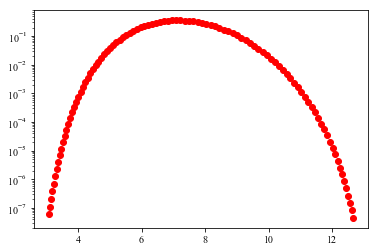

In [138]:
#initial distribution of velocity angle
sigma = 0.2
rho = 1/np.sqrt((2*np.pi*sigma**2))*np.exp(-thetalist**2/(2*sigma**2))
dtheta = thetalist[1]-thetalist[0]
print(np.sum(rho*dtheta))
plt.semilogy(thetalist,rho,'ko')


dTh = dtheta/np.diff(Xlist)
#plt.plot(thetam,dTh)
rhom = (rho[1:]+rho[:-1])/2
rho_x = rhom*dTh
xm = (Xlist[1:]+Xlist[:-1])/2
thetam = (thetalist[1:]+thetalist[:-1])/2
plt.figure()
plt.semilogy(xm,rho_x,'ro')

figure already exists


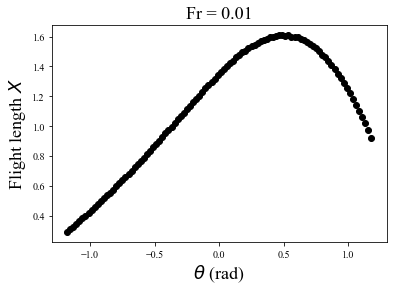

In [87]:
figs = {}
plt.figure()
plt.plot(thetalist,Xlist,'ko')
figs.update(graphes.legende(r'$\theta$ (rad)','Flight length $X$','Fr = '+str(Fr)))
graphes.save_figs(figs,savedir=savefolder,suffix='Fr_'+str(Fr))

0
1
2
3
4
5
6
7
8
9


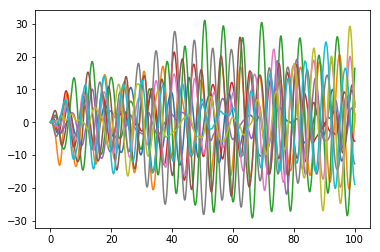

In [109]:
w0 = 1
lamb = 0.02
beta = 0
c0 = 1

sigma = 1
nc = 10
ti = np.linspace(0,110,1100+1)
t = np.linspace(0,100,10**3+1)
y0 = [0,c0]

nrun = 10
moy,ecart = [],[]

for i in range(nrun):
    print(i)
    c,cfun = make_noise(ti,sigma,nc)

#c0 = 0.25732572# for lambda = 0.1
    sol = inte.odeint(harmonic, y0, t, args=(cfun,lamb, w0,beta,0))#c0 replaced by 0
    
    moy.append(np.mean(sol))
    ecart.append(np.std(sol))
    
    n = len(t)
    plt.plot(t,sol[:,0])
    
d={}
keys = ['lamb','sigma','nc','moy','ecart']
values = [lamb,sigma,nc,moy,ecart]

for key,value in zip(keys,values):
    d[key]=value
    
d['ecartg']=np.mean(d['ecart'])
d['moyg']=np.mean(d['moy'])
data.append(d)

In [47]:
data=[]

In [209]:
w0 = 1
lambdas = np.logspace(-2,2,10)
beta = 0
c0 = 1

sigma = 1
nc = 20
N = 10**4
tmax = 10**3
ti = np.linspace(0,tmax*1.1,int(N*1.1)+1)
t = np.linspace(0,tmax,N+1)
y0 = [0,c0]
c,cfun = make_noise(ti,sigma,nc)
#c0 = 0.25732572# for lambda = 0.1
#plt.plot(ti,c)
n = len(t)
cp = c[:n]-np.mean(c[:n])
Corr = np.correlate(cp,cp,mode='same')/np.sum(cp**2)
solutions = []

for i,lamb in enumerate(lambdas):
    print(i)
    sol = inte.odeint(harmonic, y0, t, args=(cfun,lamb, w0,beta,0))#c0 replaced by 0
    solutions.append(sol)
    
#print(np.argmax(Corr))
#plt.plot(Corr[n//2:],'kx')
#x=np.linspace(0,nc,10*nc)
#plt.plot(x,1-x/nc,'r--')
#plt.axis([0,5*nc,-0.5,1.05])

0
1
2
3
4
5
6
7
8
9


In [210]:
data2 = []
for lamb,sol in zip(lambdas,solutions):
    d={}
    d['sol']=sol
    d['lamb']=lamb
    
    y = sol[:,0]-np.mean(sol[:,0])
    v = sol[:,1]-np.mean(sol[:,1])
    ddy = -lamb*v-y+c[:n]
    d['y']=y
    d['v']=v
    d['c']=c[:n]
    d['cp']=cp
    
    d['fx']=np.mean(cp*y)
    d['fv']=np.mean(cp*v)
    
    data2.append(d)

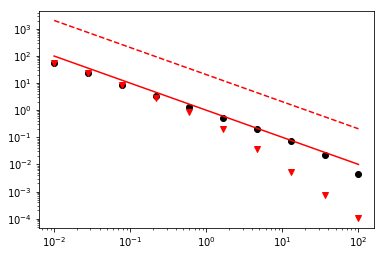

In [228]:
for d in data2:
    x = np.mean(d['y']**2)
    v = np.mean(d['v']**2)
    
    C = np.mean(d['cp']**2)
    plt.loglog(d['lamb'],x/C,'ko')
    plt.loglog(d['lamb'],v/C,'rv')
    
x = np.logspace(-2,2,100)
plt.loglog(x,C/x,'r--')
plt.loglog(x,1/x,'r-')#limite inertielle, <vf>/lambda~

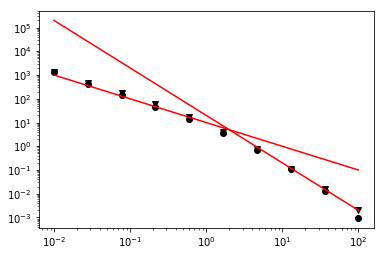

In [217]:
for d in data2:
    plt.loglog(d['lamb'],d['fx']/d['lamb'],'ko')
    plt.loglog(d['lamb'],d['fv']/d['lamb'],'kv')
    
x = np.logspace(-2,2,100)
plt.loglog(x,10/x,'r-')#limite inertielle, <vf>/lambda~
plt.loglog(x,20/x**2,'r-')#limite sur-armorti

In [208]:
print(np.mean(y**2))
print(np.mean(v**2))
print(np.mean(cp**2))
print(np.mean(v*cp))
print(np.mean(y*cp))
print(np.mean(y**2)-np.mean(v**2)-np.mean(cp*y))
print(lamb*np.mean(v**2)-np.mean(v*cp))

30.898070241655162
20.43527964395557
20.127715268062445
10.231901296147035
10.47137577777934
-0.008585180079748511
-0.014261474169249055


In [194]:
print(np.corrcoef(y,cp))
print(np.corrcoef(v,cp))
print(np.corrcoef(ddy,cp))

[[1.         0.41989512]
 [0.41989512 1.        ]]
[[1.         0.50450887]
 [0.50450887 1.        ]]
[[1.         0.20256444]
 [0.20256444 1.        ]]


In [ ]:
np.correlate(y,y,mode='same')/np.sum(y**2)

[480, 520, -1, 1.05]

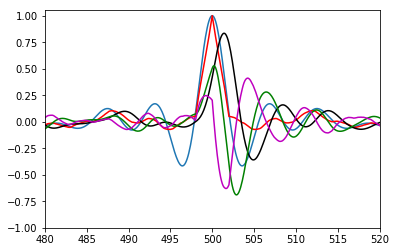

In [193]:
Corr_sol = np.correlate(y,y,mode='same')/np.sum(y**2)
Corr_crossy = np.correlate(y,cp,mode='same')/(np.sqrt(np.sum(y**2))*np.sqrt(np.sum(cp**2)))
Corr_crossv = np.correlate(v,cp,mode='same')/(np.sqrt(np.sum(v**2))*np.sqrt(np.sum(cp**2)))
Corr_crossa = np.correlate(ddy,cp,mode='same')/(np.sqrt(np.sum(ddy**2))*np.sqrt(np.sum(cp**2)))

plt.plot(t,Corr_sol)
plt.plot(t,Corr,'r')
plt.plot(t,Corr_crossy,'k')
plt.plot(t,Corr_crossv,'g')
plt.plot(t,Corr_crossa,'m')
plt.axis([500-nc*1,500+nc*1,-1,1.05])

In [56]:
#<x^2> ~ 2C/lambda, où C g((t-t')/tc) = <f(t)f(t')>

10
10
10
10
10
10
10
10
10
10
10
1
1
1
50
50


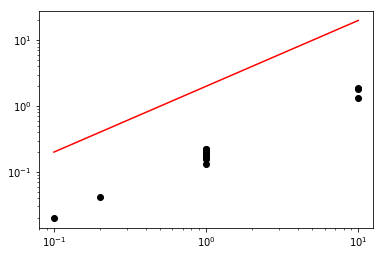

In [107]:
for dat in data:
    plt.loglog(dat['sigma'],dat['ecartg']*np.sqrt(dat['lamb'])/dat['nc'],'ko')
    print(dat['nc'])
x = np.logspace(-1,1,10)
plt.loglog(x,2*x,'r-')

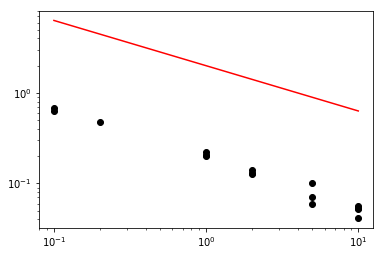

In [108]:
for dat in data:
    plt.loglog(dat['lamb'],dat['ecartg']/dat['sigma']/dat['nc'],'ko')
    
x = np.logspace(-1,1,10)
plt.loglog(x,2*x**(-1/2),'r-')

In [ ]:
#correlation time ?

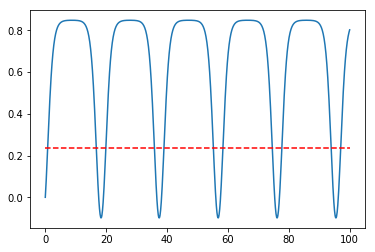

In [74]:
w0 = 1
lamb = 0
beta = 1

c0 = 0.2381181
y0 = [0,c0]
t = np.linspace(0,100,10**3+1)
sol = inte.odeint(harmonic, y0, t, args=(lamb, w0,beta,c0))

n = len(t)
plt.plot(t,sol[:,0])
plt.plot(t,c0*np.ones(n),'r--')

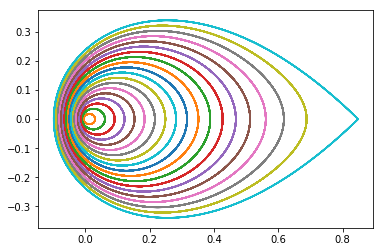

In [75]:
w0 = 1
lamb = 0
beta = 1

cmax = 0.2381181 #lambda = 0
clist = np.linspace(0,cmax,20)
for c0 in clist:
    y0 = [0,c0]
    t = np.linspace(0,100,10**3+1)
    sol = inte.odeint(harmonic, y0, t, args=(lamb, w0,beta,c0))

    #n = len(t)
    #plt.plot(t,sol[:,0])
    #plt.plot(t,c0*np.ones(n),'r--')
    plt.plot(sol[:,0],sol[:,1])

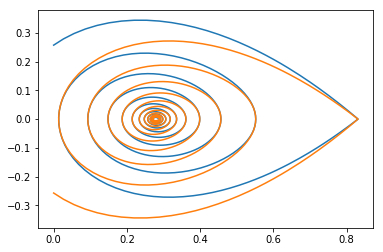

In [79]:
w0 = 1
lamb = 0.1
beta = 1

c0 = 0.25732572# for lambda = 0.1
y0 = [0,c0]
t = np.linspace(0,100,10**3+1)
sol = inte.odeint(harmonic, y0, t, args=(lamb, w0,beta,c0))

n = len(t)
plt.plot(sol[:,0],sol[:,1])
plt.plot(sol[:,0],-sol[:,1])

#plt.plot(t,c0*np.ones(n),'r--')

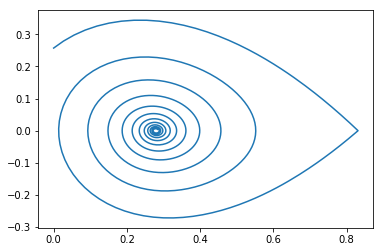

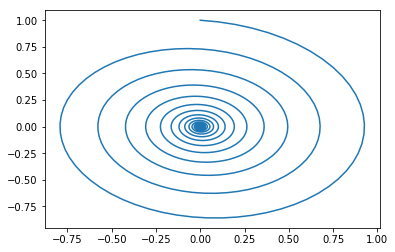

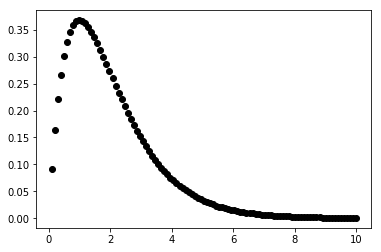

In [54]:
def fun(p):
    return 1/(p+1)**2


math.mp.dps = 15; 
math.mp.pretty = True

tlist = np.linspace(0.1,10,101)
f = []
for t in tlist:
    f.append(math.invertlaplace(fun,t,method='talbot'))
    
plt.plot(tlist,f,'ko')

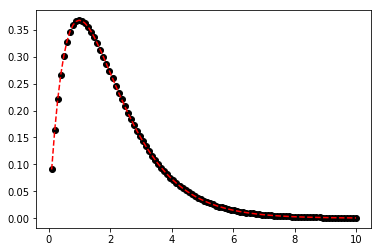

In [55]:
plt.plot(tlist,f,'ko')
plt.plot(tlist,tlist*np.exp(-tlist),'r--')

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: invalid value encountered in true_divide
  if sys.path[0] == '':


[0.01, 100, 0.01, 0.5]

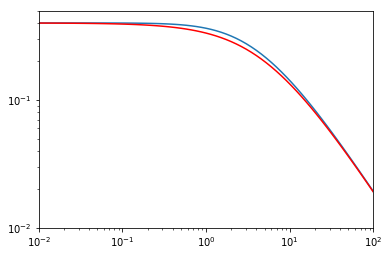

In [202]:
q = np.linspace(-3,3,101)
q = 10**q
n=2
k1 = special.kv(n+1/2,q)
k2 = special.kv(n-1/2,q)

#plt.semilogy(q,q*k1,'k^')
#plt.semilogy(q,k2,'rv')
#plt.semilogy(q**(0.25),q*k1/k2,'rv')

#plt.figure(2)
Qn = 1/(1+1/2*q*k1/k2)
#plt.loglog(q,-np.log(Qn))
#a=10
#plt.loglog(q,(q**(0.28*a)+0.91**a)**(1/a),'r--')

plt.figure(3)
plt.loglog(q,Qn)
a=10
c=0
#plt.loglog(q,c+np.exp(-(q**(0.28*a)+0.91**a)**(1/a)),'r--')
q0 = 2/0.4
a=1
plt.loglog(q,2/(q0**a+q**a)**(1/a),'r-')
plt.axis([10**-2,10**2,10**-2,0.5])

#log(-log(Qn)) ~ 1 #for q<1
#log(-log(Qn)) = alpha*log(q) #for q<1
#-log(Qn)~ q^alpha
#Qn = exp(-q^alpha)

In [192]:
a=2
r = np.linspace(-10**a,10**a,101)
#q = 10**q
im = np.linspace(-10**a,10**a,101)
#im = 10**i
[R,IM] = np.meshgrid(r,im)
Z = R+IM*1j

In [193]:
n=2
nu=10**-2
R0=1
Q = np.sqrt(R0*Z/nu)
k1 = special.kv(n+1/2,Q)
k2 = special.kv(n-1/2,Q)
Qnr = np.real(1/(1+1/2*Q*k1/k2))
Qni = np.imag(1/(1+1/2*Q*k1/k2))
Fp = Qnr+1j*Qni


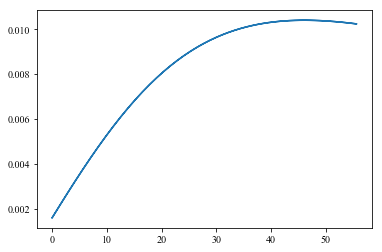

In [197]:
plt.plot(Q[:,25],np.real(Fp[:,25]))

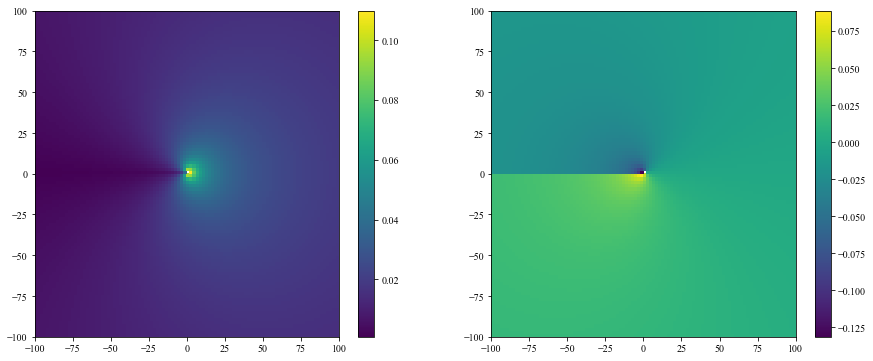

In [198]:


plt.figure(figsize=(15,6))
plt.subplot(1,2,1)
plt.pcolormesh(R,IM,Qnr)
#plt.xscale('log')
#plt.yscale('log')
plt.colorbar()

plt.subplot(1,2,2)
plt.pcolormesh(R,IM,Qni)
#plt.xscale('log')
#plt.yscale('log')
plt.colorbar()

In [90]:
print(Z.shape)
print(Fp.shape)

(51, 101)
(51, 101)


[2. 4. 6. 8.]


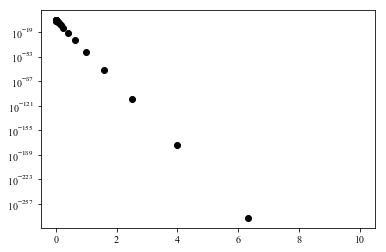

In [205]:
Fp = Qnr+1j*Qni
gamma = 1
t0 = 0.1

tlist = np.logspace(-3,1,21)
rb = r[np.logical_and(r>0,r<10)]

Ft_e = []
print(rb)
for t in tlist:
    Ft = []
    for i0,r0 in enumerate(rb):
        Ft.append(np.sum(np.exp(Z[:,i0]*t)*Fp[:,i0])/(2*np.pi*1j))

    #print(np.max(np.imag(Ft)))
    Ft_e.append(np.max(np.real(Ft)))
    #plt.plot(qb,np.real(Ft))
    #print(np.real(Ft))
    
Ft_e = np.asarray(Ft_e)
plt.figure(2)
plt.semilogy(tlist,-Ft_e,'ko')

In [ ]:

k1 = special.kv(n+1/2,q)
k2 = special.kv(n-1/2,q)

#plt.semilogy(q,q*k1,'k^')
#plt.semilogy(q,k2,'rv')
#plt.semilogy(q**(0.25),q*k1/k2,'rv')

#plt.figure(2)
#plt.loglog(q,-np.log(Qn))
#a=10
#plt.loglog(q,(q**(0.28*a)+0.91**a)**(1/a),'r--')

plt.figure(3)
plt.loglog(q,Qn)
a=10
c=0
#plt.loglog(q,c+np.exp(-(q**(0.28*a)+0.91**a)**(1/a)),'r--')
q0 = 2/0.4
a=1
plt.loglog(q,2/(q0**a+q**a)**(1/a),'r-')
plt.axis([10**-2,10**2,10**-2,0.5])

#log(-log(Qn)) ~ 1 #for q<1
#log(-log(Qn)) = alpha*log(q) #for q<1
#-log(Qn)~ q^alpha
#Qn = exp(-q^alpha)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: invalid value encountered in true_divide
  


[0.01, 100, 0.01, 0.5]

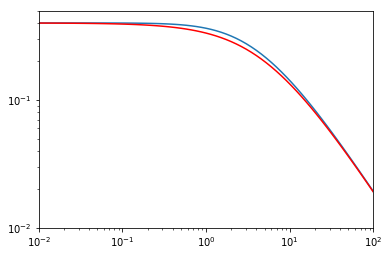

In [203]:
q = np.linspace(-3,3,101)
q = 10**q
n=2
k1 = special.kv(n+1/2,q)
k2 = special.kv(n-1/2,q)
Qn = 1/(1+1/2*q*k1/k2)

plt.figure(3)
plt.loglog(q,Qn)
q0 = 2/0.4
a=1
plt.loglog(q,2/(q0**a+q**a)**(1/a),'r-')
plt.axis([10**-2,10**2,10**-2,0.5])

#log(-log(Qn)) ~ 1 #for q<1
#log(-log(Qn)) = alpha*log(q) #for q<1
#-log(Qn)~ q^alpha
#Qn = exp(-q^alpha)

figure already exists


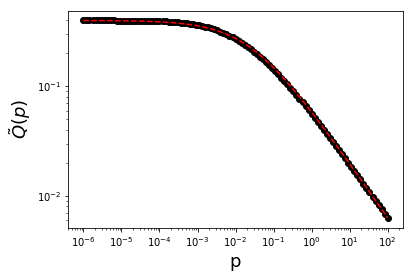

In [32]:
def Q_2(p,nu=1,n=2):
    R = 1
    epsilon = 10**-3
    q = R*(p/nu)**(1/2)
    Hn = q*special.kve(n+1/2,q)/(special.kve(n-1/2,q))
    Qn = 1/(1+1/2*Hn)#/(q+1)**2
    return Qn

def prosper(x,nu,x0=25,a=1.2,c0=2/5):
    return c0/(1+(x/x0/nu)**(a/2))**(1/a)

q = np.linspace(-6,2,101)
plist = 10**q
nu=10**(-3)
plt.loglog(plist,Q_2(plist,nu=nu),'ko')
a=1.2
plt.loglog(plist,prosper(plist,nu,a=a),'r--')
fig = graphes.legende('p',r'$\tilde Q(p)$','')
graphes.save_figs(fig,savedir=savefolder)

1.0
0.01
0.0001


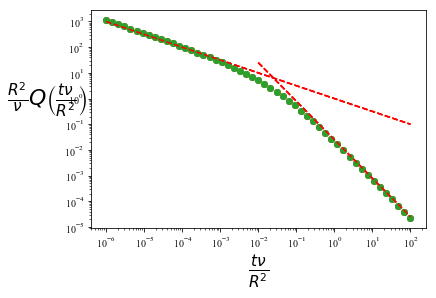

In [345]:
nulist = np.logspace(0,-4,3)
for nu in nulist:
    tlist = np.logspace(-6-np.log10(nu),2-np.log10(nu),51)
    f=[]
    print(nu)
    for t in tlist:
        f.append(math.invertlaplace(lambda x: prosper(x,nu,a=1),t))
        
    tup = np.logspace(-2,2,101)
    plt.loglog(tlist*nu,f/nu,'o')
    plt.loglog(tlist*nu,(tlist*nu)**(-1/2),'r--')
    plt.loglog(tup,1/40*(tup)**(-3/2),'r--')

fig = graphes.legende(r'$\frac{t \nu}{R^2}$',r'$\frac{R^2}{\nu} Q\left(\frac{t\nu}{R^2} \right)$','')
graphes.save_figs(fig,savedir=savefolder)
#plt.loglog(tup/nu,10**6*1/4*(tup/nu)**(-3/2),'r--')

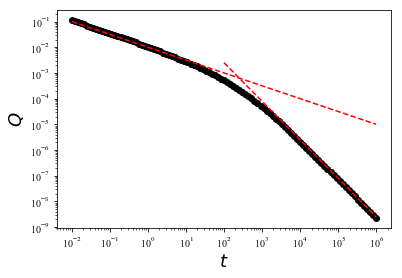

In [289]:
plt.loglog(tlist,f,'ko')
plt.loglog(tlist,0.01*tlist**(-1/2),'r--')

tup = np.logspace(2,6,101)
plt.loglog(tup,0.01/4*(tup/10**2)**(-3/2),'r--')

#plt.loglog(tlist,0.1*tlist**(-1),'r--')
fig = graphes.legende('$t$','$Q$','')

In [60]:
def RQ_lines(A,B,E):
    n = np.shape(E)[0]
    
    R = np.zeros(n)
    Q = np.zeros(n)
    for i,e in enumerate(E):
        a = e*A
        b = e*B
        r,q = compute_RQ(a,b)
        R[i] = r
        Q[i] = q
    return (R,Q)

def RQ_eps(A,B,E):
    n = np.shape(E)[0]
    
    R = np.zeros(n)
    Q = np.zeros(n)
    for i,e in enumerate(E):
        a = e*A
        b = e*B
        r,q = compute_RQ(a,b)
        R[i] = r
        Q[i] = q
    return (R,Q)


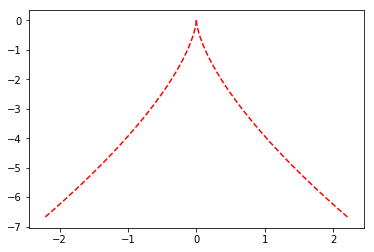

In [61]:
A = np.asarray([-1/2,-1/2,1])
B = np.asarray([0,0,0])
E = np.arange(0,3,0.01)

R,Q = RQ_lines(A,B,E)
plt.plot(R,Q,'r--')
plt.plot(-R,Q,'r--')

A = np.asarray([-1/2,-1/2,1])
B = np.asarray([0,0,0])
E = np.arange(0,3,0.01)


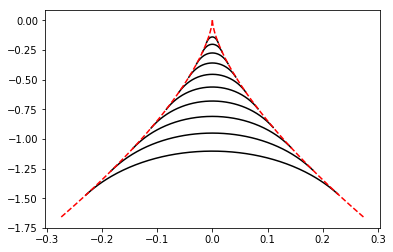

In [62]:
# plot directly in two dimensions
# for the positive determininant zone, we define eps such that
Eps = np.arange(-1,1,0.01)
e = 1
E = np.arange(0.5,1.5,0.1)

n = np.shape(Eps)[0]


for j,e in enumerate(E):
    R = np.zeros(n)
    Q = np.zeros(n)
    for i,eps in enumerate(Eps):
        A = np.asarray([(3-eps)/4,eps/2,-(3+eps)/4])
        B = np.asarray([0,0,0])

        a = e*A
        b = e*B
        r,q = compute_RQ(a,b)
        R[i] = r
        Q[i] = q
    
    plt.plot(R,Q,'k-')

A = np.asarray([-1/2,-1/2,1])
B = np.asarray([0,0,0])
E = np.arange(0,1.5,0.01)

R,Q = RQ_lines(A,B,E)
plt.plot(R,Q,'r--')
plt.plot(-R,Q,'r--')

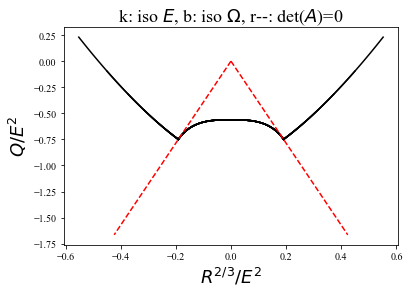

In [130]:
# plot directly in two dimensions
# for the negative determininant zone, two eigenvalues are complex conjugates
Eps = np.arange(-1,1,0.01)
E = np.arange(1.,2.,0.1)
n = np.shape(Eps)[0]
for j,e in enumerate(E):
    R = np.zeros(n)
    Q = np.zeros(n)
    for i,eps in enumerate(Eps):
        A = np.asarray([(3-eps)/4,eps/2,-(3+eps)/4])
        B = np.asarray([0,0,0])

        a = e*A
        b = B
        r,q = compute_RQ(a,b)
        R[i] = r
        Q[i] = q

    plt.plot(np.sign(R)*np.abs(R)**(2/3)/e**2,Q/e**2,'k-')
    

Eps = [-1,1]
E = np.arange(1.,2.,0.1)

#E = np.arange(0.5,1.5,0.1)


for eps in Eps:
    for e in E:
        O = np.arange(0,(2-e),0.01)
        n = np.shape(O)[0]    

        R = np.zeros(n)
        Q = np.zeros(n)
        for i,o in enumerate(O):
            A = np.asarray([(3-eps)/4,eps/2,-(3+eps)/4])
            B = np.asarray([o*(eps+1)/2,-o,o*(1-eps)/2])
    
            a = e*A
            b = B
            r,q = compute_RQ(a,b)
            R[i] = r
            Q[i] = q
    
        if eps>0:
            plt.plot(R**(2/3)/e**2,Q/e**2,'k-')
        else:
            plt.plot(-(-R)**(2/3)/e**2,Q/e**2,'k-')
            
O = np.arange(0,2,0.1)
            
for eps in Eps:
    for o in O:
        E = np.arange(0,1.5-o/2,0.1)
        n = np.shape(E)[0]    

        R = np.zeros(n)
        Q = np.zeros(n)
        
        for i,e in enumerate(E):
            A = np.asarray([(3-eps)/4,eps/2,-(3+eps)/4])
            B = np.asarray([o*(eps+1)/2,-o,o*(1-eps)/2])
    
            a = e*A
            b = B
            r,q = compute_RQ(a,b)
            R[i] = r
            Q[i] = q
    
        #if eps>0:
        #    plt.plot(R**(2/3),Q,'b-')
        #else:
        #    plt.plot(-(-R)**(2/3),Q,'b-')
            

A = np.asarray([-1/2,-1/2,1])
B = np.asarray([0,0,0])
E = np.arange(0,1.5,0.01)

R,Q = RQ_lines(A,B,E)
plt.plot((-R)**(2/3),Q,'r--')
plt.plot(-(-R)**(2/3),Q,'r--')


figs = {}
figs.update(graphes.legende('$R^{2/3}/E^2$','$Q/E^2$','k: iso $E$, b: iso $\Omega$, r--: det($A$)=0'))
graphes.save_figs(figs,savedir=savefolder+'Plane_RQ_homothetie',prefix='',frmt='pdf')

In [124]:
glob.glob(savefolder+'*')

['/Users/stephane/Documents/Programming/Python/Notebooks/Flow geometry/Plane_RQQ_vs_R_23.pkl',
 '/Users/stephane/Documents/Programming/Python/Notebooks/Flow geometry/RQ_plane.ipynb']

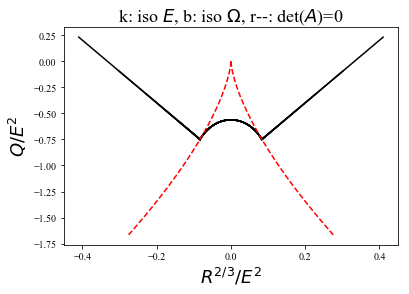

In [133]:
# plot directly in two dimensions
# for the negative determininant zone, two eigenvalues are complex conjugates
Eps = np.arange(-1,1,0.01)
E = np.arange(1.,2.,0.1)
n = np.shape(Eps)[0]
for j,e in enumerate(E):
    R = np.zeros(n)
    Q = np.zeros(n)
    for i,eps in enumerate(Eps):
        A = np.asarray([(3-eps)/4,eps/2,-(3+eps)/4])
        B = np.asarray([0,0,0])

        a = e*A
        b = B
        r,q = compute_RQ(a,b)
        R[i] = r
        Q[i] = q

    plt.plot(R/e**3,Q/e**2,'k-')
    

Eps = [-1,1]
E = np.arange(1.,2.,0.1)

#E = np.arange(0.5,1.5,0.1)


for eps in Eps:
    for e in E:
        O = np.arange(0,(2-e),0.01)
        n = np.shape(O)[0]    

        R = np.zeros(n)
        Q = np.zeros(n)
        for i,o in enumerate(O):
            A = np.asarray([(3-eps)/4,eps/2,-(3+eps)/4])
            B = np.asarray([o*(eps+1)/2,-o,o*(1-eps)/2])
    
            a = e*A
            b = B
            r,q = compute_RQ(a,b)
            R[i] = r
            Q[i] = q
    
        plt.plot(R/e**3,Q/e**2,'k-')
            
O = np.arange(0,2,0.1)
            
for eps in Eps:
    for o in O:
        E = np.arange(0,1.5-o/2,0.1)
        n = np.shape(E)[0]    

        R = np.zeros(n)
        Q = np.zeros(n)
        
        for i,e in enumerate(E):
            A = np.asarray([(3-eps)/4,eps/2,-(3+eps)/4])
            B = np.asarray([o*(eps+1)/2,-o,o*(1-eps)/2])
    
            a = e*A
            b = B
            r,q = compute_RQ(a,b)
            R[i] = r
            Q[i] = q
    
        #if eps>0:
        #    plt.plot(R**(2/3),Q,'b-')
        #else:
        #    plt.plot(-(-R)**(2/3),Q,'b-')
            

A = np.asarray([-1/2,-1/2,1])
B = np.asarray([0,0,0])
E = np.arange(0,1.5,0.01)

R,Q = RQ_lines(A,B,E)
plt.plot(R,Q,'r--')
plt.plot(-R,Q,'r--')


figs = {}
figs.update(graphes.legende('$R^{2/3}/E^2$','$Q/E^2$','k: iso $E$, b: iso $\Omega$, r--: det($A$)=0'))
graphes.save_figs(figs,savedir=savefolder+'Plane_RQ_norescale',prefix='',frmt='pdf')

In [ ]:
#l**3+Q*l+R=0
a = [-1,0,1]; #partie réelle des valeurs propres
b = [0,0,0]; #partie imaginaire
#l = np.asarray([np.complex(a0,b0) for (a0,b0) in zip(a,b)])

def compute_RQ(a,b):
    l = np.asarray([np.complex(a0,b0) for (a0,b0) in zip(a,b)])

    R = np.real(-1/3*np.prod(l));#to force the type
    Q = np.real(-1/2*np.sum(l**2))
    return (R,Q)

#from (R,Q) representation, we want to compute 
# - the couple (E,eps) for diagonalizable A (in R),
# - the couple (E,Omega) for non diagonalizable A (in R).
#R = -1/3(l1l2(-1)(l2+l1) = 1/3*l1l2(l1+l2)
#A = np.asarray([(3-eps)/4,eps/2,-(3+eps)/4])
R = 1/3*E**3/2**5*eps(9-eps**2)
Q = -3/16*E**2*(3+eps**2)
